# Read PDB files and access to carbonyl carbons

In [1]:
import math
import pandas as pd
import sys
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split


pd.set_option('display.max_columns',None)
pd.set_option('display.max_rows',None)
pd.set_option('display.width',None)
pd.set_option('display.max_colwidth',None)
srt_i =0#srt_i=int(sys.argv[1])
stp_i = 999999 #stp_i=int(sys.argv[2])
data_dir = "../data"
with open("../data/pdb_list.txt", encoding="utf-8") as f:
    read_data = f.read()
    pdb_list = read_data.split('\n')

print("number of pdbs = %s"%len(pdb_list))

if stp_i < len(pdb_list):
    pdb_list = pdb_list[srt_i:stp_i]
else:
    pdb_list = pdb_list[srt_i:]
    stp_i=len(pdb_list)
print("number of pdbs = %s"%len(pdb_list))
print(pdb_list[:10])

number of pdbs = 22268
number of pdbs = 22268
['121p_A', '13pk_A', '13pk_B', '13pk_C', '13pk_D', '1a0c_A', '1a0c_B', '1a0c_C', '1a0c_D', '1a0d_A']


## Active sites (MAHOMES)

#### MAHOMES I

In [2]:
df = pd.read_csv('../results/sites.csv', header=0)
df['pdb_name'] = df['PDB ID'] + "_" + df['Chain ID']
df_sites = df.loc[:, [ 'pdb_name', 'resName1', 'resName2', 'resName3', 'resName4', 'seqNum1', 'seqNum2', 'seqNum3', 'seqNum4']]

X_train, X_test = train_test_split(df_sites, test_size=0.1)
print(df.shape)
print(X_train.shape)
print(X_test.shape)


(3985, 31)
(3586, 9)
(399, 9)


#### MAHOMES II

In [3]:
df2 = pd.read_csv('../results/sites2.csv', header=0)
#dfx['pdb_name'] = dfx['PDB ID'] + "_" + dfx['Chain ID']
df2_sites = df2.loc[:, [ 'pdb_name', 'resName1', 'resName2', 'resName3', 'resName4', 'seqNum1', 'seqNum2', 'seqNum3', 'seqNum4']]
df2_sites.shape

(8807, 9)

In [4]:
df2n=df2_sites.copy()
df2n["pdb_uniq"]= df2n['pdb_name'].astype(str) + "_" + df2n['resName1'].astype(str) + "_" + df2n['seqNum1'].astype(str)
print(df2n.shape)
df2n = df2n.drop_duplicates(subset=['pdb_uniq'])
df2n.drop(['pdb_uniq'], axis=1, inplace=True)
print(df2n.columns)
df2n.head(2)

(8807, 10)
Index(['pdb_name', 'resName1', 'resName2', 'resName3', 'resName4', 'seqNum1',
       'seqNum2', 'seqNum3', 'seqNum4'],
      dtype='object')


,pdb_name,resName1,resName2,resName3,resName4,seqNum1,seqNum2,seqNum3,seqNum4
0,1a0e_A,CO,NaN,NaN,NaN,493,NaN,NaN,NaN
1,1a7i_A,ZN,NaN,NaN,NaN,83,NaN,NaN,NaN


## Read PDB files

In [5]:
import pandas as pd
import numpy as np
from Bio.PDB import PDBParser 
from Bio.PDB import *

METAL_RES_CODES= [ "FE" ,"FE2","FES","FEO"
                 ,"CU" ,"CU1","CUA"
                 ,"MG" ,"ZN" ,"MN"
                 ,"MO" ,"MOO","MOS"
                 ,"NI" ,"3CO","CO"]

# Extract carbonyl carbons 
def extract_c_carbonyl(struct, pdb_file):
  parser = PDBParser()
  structure = parser.get_structure(struct, pdb_file)
  carbonyl_carbons = []
  for chain in structure.get_chains():
    for residue in chain.get_residues():
      for atom in residue.get_atoms():
        if atom.get_name() == "C":
          carbonyl_carbons.append(atom.coord)
  return carbonyl_carbons

# Extract hetero atoms 
def get_hetatm(struct, pdb_file):
  parser = PDBParser()
  structure = parser.get_structure(struct, pdb_file)
  hetatms = []
  for model in structure:
    for chain in model:
       for residue in chain:
          if residue.id[0] != ' ' and residue.id[0] != 'W':
            for atom in residue.get_atoms():
              hetatms.append({
                "x": atom.coord[0],"y": atom.coord[1],"z": atom.coord[2],
                "atom_name": atom.name, "atom_num": residue.id[1]})
  hetatm_df = pd.DataFrame(hetatms)
  hetatm_metals = hetatm_df.loc[hetatm_df["atom_name"].isin(METAL_RES_CODES)]
  return hetatm_metals

# evaluate active sites (one or multiple metal ions) 
def metal_sites(struct, pdb_file):
  metals0 = get_hetatm(struct, pdb_file)
  for metal in metals0:
    print(len(metal))


#Calculate distance from carbonyl carbons to hetero atoms
def calc_distance(A, B):
    x1, y1, z1 = A
    x2, y2, z2 = B
    distance = math.sqrt((x2 - x1)**2 + (y2 - y1)**2 + (z2 - z1)**2)
    return distance

#Select the shortest distance to any metal ions
def metal_carbonyl_dist(struct, pdb_file, threshold):
  carbonyl_cs = extract_c_carbonyl(struct, pdb_file)
  hetatms = get_hetatm(struct, pdb_file)
  distances =[]
  for i in range(len(carbonyl_cs)):
    metal_dist =[]
    for j in range(len(hetatms)):
      d0 = calc_distance(carbonyl_cs[i], hetatms[j])
      metal_dist.append(d0)
    distances.append(min(metal_dist))
  dist_le15 = [x for x in distances if x <= threshold]
  return dist_le15


In [32]:
def hetatm_sites(i):
    rowi = df2n.iloc[i,:]
    site_atoms = rowi.iloc[5:,].values.flatten().tolist()
    site_atoms = np.array(site_atoms)[np.isfinite(site_atoms)]
    site_atoms = np.rint(site_atoms).astype(int)
    name = rowi["pdb_name"]
    pdb_file = "../%s/%s/%s/%s/%s_Rlx.pdb"%('data', name[0], name[1], name, name)
    try:
        metals0 = get_hetatm(name, pdb_file)
        metals1 = metals0[metals0['atom_num'].isin(site_atoms)]
        print("Run %s: %s"%(i+1, name))
        if metals1.shape[0] >1:
            metals2 = pd.DataFrame({
                "x": [metals1["x"].mean()], 
                "y": [metals1["y"].mean()], 
                "z": [metals1["z"].mean()],
                "atom_name": [rowi["resName1"]], 
                "atom_num": [metals1["atom_num"].iloc[0]] })
        else: 
            metals2 = metals1.copy()
            metals2["atom_name"] = rowi["resName1"]

    except:
        print("%s not found!!!"%(name))
    
    carbonyl_cs = extract_c_carbonyl(name, pdb_file)
    distances =[]
    for i in range(len(carbonyl_cs)):
        hetatms = metals2.iloc[0,0:3].values.flatten().tolist()
        d0 = calc_distance(carbonyl_cs[i], hetatms)
        df0 = pd.DataFrame({"pdb_name":name, 
                            "metal_name": [metals2["atom_name"].iloc[0]],
                            "metal_number": [metals2["atom_num"].iloc[0]],
                            "x_met": [metals2["x"].iloc[0]], 
                            "y_met": [metals2["y"].iloc[0]],
                            "z_met": [metals2["z"].iloc[0]],
                            "dist_c_metal": d0})
        distances.append(df0)
    full_distances = pd.concat(distances, ignore_index=True)
    return full_distances

In [34]:
#posis = range(4)
posis = range(len(df2n['pdb_name']))
all_distances = []
for i in posis:
    try:
        single_dist = hetatm_sites(i)
        all_distances.append(single_dist)
    except:
        print("PDB file not available")
        pass
final_distances= pd.concat(all_distances, ignore_index=True)
print("Full data:",final_distances.shape)
final_distances.tail(2)

Run 1: 1a0e_A
Run 2: 1a7i_A
Run 3: 1aaf_A
Run 4: 1aaf_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 6437
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 6438
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 6439
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 6440
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 6441
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 5: 1af6_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'GLU_18' at line 6629
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'LEU_18' at line 6630
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'GLY_19' at line 6631
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'VAL_19' at line 6632
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'ASP_19' at line 6633
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 6: 1ag0_A
Run 7: 1ajy_A
Run 8: 1ak0_A
Run 9: 1amf_A
Run 10: 1aol_A
Run 11: 1aol_A
Run 12: 1ard_A
Run 13: 1b0n_A
Run 14: 1b0n_A
Run 15: 1b4e_A
Run 16: 1b8c_A
Run 17: 1b8t_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 3985
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 3986
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 3987
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 3988
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 3989
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 18: 1b9m_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 6625
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 6626
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 6627
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 6628
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 6629
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 19: 1bk5_B
Run 20: 1bor_A
Run 21: 1bor_A
Run 22: 1bt0_A
Run 23: 1btg_B
Run 24: 1byf_A
Run 25: 1byf_A
Run 26: 1byf_A
Run 27: 1cc3_A
Run 28: 1cdo_A
Run 29: 1cg2_A
Run 30: 1cgf_B
Run 31: 1chc_A
Run 32: 1chc_A
Run 33: 1ci3_M
Run 34: 1ci3_M
Run 35: 1cl4_A
Run 36: 1cmc_A
Run 37: 1co4_A
Run 38: 1cpr_A
Run 39: 1cpr_A
Run 40: 1cpr_A
Run 41: 1cuo_A
Run 42: 1cur_A
Run 43: 1cvr_A
Run 44: 1czf_A
Run 45: 1czf_A
Run 46: 1d1s_A
Run 47: 1d1s_A
Run 48: 1d1s_A
Run 49: 1d4u_A
Run 50: 1dck_B
Run 51: 1dfe_A
Run 52: 1dfx_A
Run 53: 1dg6_A
Run 54: 1doi_A
Run 55: 1dox_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 4415
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 4416
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 4417
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 4418
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 4419
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 56: 1dqv_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 4415
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 4416
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 4417
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 4418
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 4419
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 57: 1dqv_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 4415
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 4416
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 4417
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 4418
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 4419
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 58: 1dqv_A
Run 59: 1dsq_A
Run 60: 1dsv_A
Run 61: 1dv6_H
Run 62: 1dx8_A
Run 63: 1dy0_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 3121
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 3122
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 3123
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 3124
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 3125
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 64: 1e0o_B
Run 65: 1e3i_A
Run 66: 1e3j_A
Run 67: 1e4u_A
Run 68: 1e4u_A
Run 69: 1ecc_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 2921
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 2922
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 2923
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 2924
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 2925
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 70: 1eje_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 2921
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 2922
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 2923
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 2924
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 2925
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 71: 1eje_A
Run 72: 1ek0_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 1861
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 1862
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 1863
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 1864
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 1865
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 73: 1elw_A
Run 74: 1elw_A
Run 75: 1esk_A
Run 76: 1ete_A
Run 77: 1eu3_A
Run 78: 1eu4_A
Run 79: 1ew2_A
Run 80: 1ewc_A
Run 81: 1exk_A
Run 82: 1exk_A
Run 83: 1ext_A
Run 84: 1f1m_A
Run 85: 1f56_A
Run 86: 1f5f_A
Run 87: 1f62_A
Run 88: 1f62_A
Run 89: 1f81_A
Run 90: 1f81_A
Run 91: 1f81_A
Run 92: 1f8f_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 10768
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 10769
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 10770
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 10771
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 10772
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarn

Run 93: 1fi1_A
Run 94: 1fio_A
Run 95: 1fn9_A
Run 96: 1fp0_A
Run 97: 1fp0_A
Run 98: 1fr9_A
Run 99: 1frd_A
Run 100: 1fre_A
Run 101: 1fu9_A
Run 102: 1fuk_A
Run 103: 1fv5_A
Run 104: 1fvu_B
Run 105: 1fwq_A
Run 106: 1fx7_A
Run 107: 1fx7_A
Run 108: 1fx7_A
Run 109: 1g29_1
Run 110: 1g29_1
Run 111: 1g29_1
Run 112: 1g43_A
Run 113: 1g43_A
Run 114: 1g47_A
Run 115: 1g73_D
Run 116: 1ga2_A
Run 117: 1gud_A
Run 118: 1gud_A
Run 119: 1gzc_A
Run 120: 1h2b_A
Run 121: 1h2b_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 2105
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 2106
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 2107
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 2108
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 2109
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 122: 1h9r_B
Run 123: 1h9u_C


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 3260
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 3261
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 3262
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 3263
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 3264
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 124: 1he1_A
Run 125: 1he1_C
Run 126: 1he1_C
Run 127: 1hfc_A
Run 128: 1hfs_A
Run 129: 1hj1_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 3332
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 3333
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 3334
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 3335
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 3336
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 130: 1hj1_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 4130
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 4131
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 4132
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 4133
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 4134
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 131: 1hk7_A
Run 132: 1hov_A
Run 133: 1hp7_A
Run 134: 1hp7_A
Run 135: 1hp7_A
Run 136: 1hp7_A
Run 137: 1hql_A
Run 138: 1hra_A
Run 139: 1hra_A
Run 140: 1htw_A
Run 141: 1hv5_A
Run 142: 1hxr_A
Run 143: 1hyi_A
Run 144: 1hyi_A
Run 145: 1i1i_P
Run 146: 1i27_A
Run 147: 1i76_A
Run 148: 1i7w_A
Run 149: 1ibi_A
Run 150: 1ibq_A
Run 151: 1ibq_A
Run 152: 1ibq_A
Run 153: 1ic0_A
Run 154: 1ido_A
Run 155: 1ig5_A
Run 156: 1iml_A
Run 157: 1iml_A
Run 158: 1io0_A
Run 159: 1iue_A
Run 160: 1iwl_A
Run 161: 1iwl_A
Run 162: 1iwl_A
Run 163: 1iym_A
Run 164: 1iym_A
Run 165: 1j98_A
Run 166: 1jcc_B
Run 167: 1jed_A
Run 168: 1jer_A
Run 169: 1jjd_A
Run 170: 1jjt_A
Run 171: 1jlk_A
Run 172: 1jm7_A
Run 173: 1jm7_B
Run 174: 1jm7_B
Run 175: 1job_A
Run 176: 1job_A
Run 177: 1job_A
Run 178: 1joe_A
Run 179: 1jq5_A
Run 180: 1jz7_A
Run 181: 1jzs_A
Run 182: 1k0v_A
Run 183: 1k24_A
Run 184: 1k24_A
Run 185: 1k24_A
Run 186: 1k51_A
Run 187: 1k77_A
Run 188: 1k81_A
Run 189: 1k9z_A
Run 190: 1k9z_A
Run 191: 1k9z_A
Run 192: 1k9z_A
Run 193:

/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 1661
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 1662
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 1663
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 1664
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 1665
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 215: 1lm3_B
Run 216: 1lpv_A
Run 217: 1lpv_A
Run 218: 1lr5_A
Run 219: 1ls1_A
Run 220: 1ltl_A
Run 221: 1lv3_A
Run 222: 1m2a_A
Run 223: 1m2a_A
Run 224: 1m2x_B
Run 225: 1m36_A
Run 226: 1m55_A
Run 227: 1m55_A
Run 228: 1m5e_B
Run 229: 1m5e_B
Run 230: 1m9o_A
Run 231: 1mb3_A
Run 232: 1mkm_A
Run 233: 1mm2_A
Run 234: 1mr1_C
Run 235: 1mrp_A
Run 236: 1muw_A
Run 237: 1mvo_A
Run 238: 1mwq_B
Run 239: 1mxd_A
Run 240: 1mxd_A
Run 241: 1mxd_A
Run 242: 1mxd_A
Run 243: 1mxd_A
Run 244: 1mzb_A
Run 245: 1mzb_A
Run 246: 1mzb_A
Run 247: 1mzb_A
Run 248: 1n67_A
Run 249: 1n67_A
Run 250: 1nc8_A
Run 251: 1ncs_A
Run 252: 1nee_A
Run 253: 1nfv_A
Run 254: 1nn7_A
Run 255: 1nnq_A
Run 256: 1nnt_A
Run 257: 1no5_A
Run 258: 1no5_A
Run 259: 1no5_A
Run 260: 1nr0_A
Run 261: 1nrj_B
Run 262: 1nu4_B
Run 263: 1nu5_A
Run 264: 1nwp_A
Run 265: 1nwp_A
Run 266: 1nyr_A
Run 267: 1o6t_A
Run 268: 1o9t_A
Run 269: 1ohf_A
Run 270: 1on1_A
Run 271: 1ons_A
Run 272: 1oqj_A
Run 273: 1ot8_A
Run 274: 1ou8_A
Run 275: 1ovt_A
Run 276: 1p7a_A
Run 277:

/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 1938
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 1939
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 1940
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 1941
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 1942
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 331: 1shw_A
Run 332: 1si1_A
Run 333: 1sl5_A
Run 334: 1sum_B


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 3683
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 3684
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 3685
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 3686
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 3687
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 335: 1sum_B


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 3683
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 3684
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 3685
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 3686
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 3687
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 336: 1sum_B


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 3683
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 3684
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 3685
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 3686
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 3687
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 337: 1sum_B
Run 338: 1svm_A
Run 339: 1sw1_A
Run 340: 1t4w_A
Run 341: 1t5l_A
Run 342: 1t8h_A
Run 343: 1taf_B
Run 344: 1taf_B
Run 345: 1tfi_A
Run 346: 1tjl_A
Run 347: 1tl4_A
Run 348: 1tu4_B
Run 349: 1txl_A
Run 350: 1ty2_A
Run 351: 1u19_A
Run 352: 1u5k_A
Run 353: 1u5s_B
Run 354: 1u5s_B
Run 355: 1u9k_A
Run 356: 1u9k_A
Run 357: 1ue1_B
Run 358: 1uku_A
Run 359: 1ul4_A
Run 360: 1ul4_A
Run 361: 1ul5_A
Run 362: 1ul5_A
Run 363: 1ums_A
Run 364: 1uns_A
Run 365: 1uqw_A
Run 366: 1uqw_A
Run 367: 1urj_A
Run 368: 1uuf_A
Run 369: 1uup_A
Run 370: 1uwm_A
Run 371: 1v1f_A
Run 372: 1v5n_A
Run 373: 1v5n_A
Run 374: 1v5r_A
Run 375: 1v6g_A
Run 376: 1v6g_A
Run 377: 1v6m_C
Run 378: 1v6p_A
Run 379: 1v6p_A
Run 380: 1v6p_A
Run 381: 1v7p_C
Run 382: 1v87_A
Run 383: 1v87_A
Run 384: 1va1_A
Run 385: 1va3_A
Run 386: 1vcl_A
Run 387: 1vcl_A
Run 388: 1ve0_A
Run 389: 1vfy_A
Run 390: 1vfy_A
Run 391: 1vj0_A
Run 392: 1vj2_A
Run 393: 1vk9_A
Run 394: 1vkm_A
Run 395: 1vlg_A
Run 396: 1vpy_A
Run 397: 1vq0_A
Run 398: 1vyk_A
Run 399:

/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 6530
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 6531
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 6532
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 6533
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 6534
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 409: 1w9h_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 6530
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 6531
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 6532
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 6533
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 6534
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 410: 1w9h_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 6530
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 6531
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 6532
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 6533
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 6534
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 411: 1w9h_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 6530
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 6531
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 6532
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 6533
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 6534
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 412: 1w9h_A
Run 413: 1wdc_B
Run 414: 1we9_A
Run 415: 1wee_A
Run 416: 1wee_A
Run 417: 1wen_A
Run 418: 1wen_A
Run 419: 1wep_A
Run 420: 1weq_A
Run 421: 1weq_A
Run 422: 1wes_A
Run 423: 1wev_A
Run 424: 1wev_A
Run 425: 1wew_A
Run 426: 1wew_A
Run 427: 1wfe_A
Run 428: 1wfh_A
Run 429: 1wfh_A
Run 430: 1wfk_A
Run 431: 1wfk_A
Run 432: 1wfl_A
Run 433: 1wfl_A
Run 434: 1wfp_A
Run 435: 1wfp_A
Run 436: 1wfz_A
Run 437: 1wg2_A
Run 438: 1wg2_A
Run 439: 1wge_A
Run 440: 1wig_A
Run 441: 1wii_A
Run 442: 1wil_A
Run 443: 1wim_A
Run 444: 1wim_A
Run 445: 1wj0_A
Run 446: 1wj2_A
Run 447: 1wjp_A
Run 448: 1wjp_A
Run 449: 1wjv_A
Run 450: 1wjv_A
Run 451: 1wri_A
Run 452: 1ws8_A
Run 453: 1wyh_A
Run 454: 1wyh_A
Run 455: 1wys_A
Run 456: 1x3c_A
Run 457: 1x3h_A
Run 458: 1x4j_A
Run 459: 1x4j_A
Run 460: 1x4k_A
Run 461: 1x4k_A
Run 462: 1x4l_A
Run 463: 1x4l_A
Run 464: 1x4s_A
Run 465: 1x4s_A
Run 466: 1x4u_A
Run 467: 1x4u_A
Run 468: 1x4v_A
Run 469: 1x4v_A
Run 470: 1x4w_A
Run 471: 1x4w_A
Run 472: 1x5w_A
Run 473: 1x61_A
Run 474:

/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 2365
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 2366
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 2367
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 2368
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 2369
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 497: 1xm5_A
Run 498: 1xmv_A
Run 499: 1xoc_A
Run 500: 1xoc_A
Run 501: 1xoc_A
Run 502: 1xoc_A
Run 503: 1xoc_A
Run 504: 1xoc_A
Run 505: 1xoc_A
Run 506: 1xvx_A
Run 507: 1xvx_A
Run 508: 1xvx_A
Run 509: 1xvx_A
Run 510: 1xvx_A
Run 511: 1xvx_A
Run 512: 1xwh_A
Run 513: 1y02_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 2751
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 2752
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 2753
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 2754
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 2755
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 514: 1y1o_A
Run 515: 1y63_A
Run 516: 1y63_A
Run 517: 1y63_A
Run 518: 1y63_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 3360
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 3361
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 3362
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 3363
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 3364
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 519: 1y7p_A
Run 520: 1y8a_A
Run 521: 1y8f_A
Run 522: 1y8f_A
Run 523: 1y9a_C
Run 524: 1y9a_C
Run 525: 1ycs_A
Run 526: 1yd1_A
Run 527: 1yd3_A
Run 528: 1yej_L
Run 529: 1yej_L
Run 530: 1yej_L
Run 531: 1yej_L
Run 532: 1yej_L
Run 533: 1yhu_B
Run 534: 1ylk_A
Run 535: 1ym3_A
Run 536: 1yn4_A
Run 537: 1yqd_B
Run 538: 1ys7_A
Run 539: 1yu2_A
Run 540: 1yu4_A
Run 541: 1z08_D
Run 542: 1z3h_A
Run 543: 1z3i_X
Run 544: 1z60_A
Run 545: 1z6n_A
Run 546: 1z6o_M
Run 547: 1z72_B
Run 548: 1z7h_A
Run 549: 1z83_A
Run 550: 1z84_B
Run 551: 1zd0_A
Run 552: 1zfd_A
Run 553: 1zfo_A
Run 554: 1zfp_E
Run 555: 1zh4_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 5741
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 5742
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 5743
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 5744
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 5745
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 556: 1ziu_A
Run 557: 1zle_A
Run 558: 1zle_A
Run 559: 1zn2_A
Run 560: 1znf_A
Run 561: 1zno_A
Run 562: 1zqz_A
Run 563: 1zr9_A
Run 564: 1zu1_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 1036
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 1037
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 1038
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 1039
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 1040
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 565: 1zuk_A
Run 566: 1zuu_A
Run 567: 2a1k_A
Run 568: 2a51_A
Run 569: 2a51_A
Run 570: 2a5l_A
Run 571: 2a5v_D
Run 572: 2aan_A
Run 573: 2ak1_H
Run 574: 2ak1_H
Run 575: 2akf_A
Run 576: 2ale_A
Run 577: 2aqc_A
Run 578: 2avu_F
Run 579: 2awy_A
Run 580: 2ayd_A
Run 581: 2ayj_A
Run 582: 2azh_A
Run 583: 2b06_A
Run 584: 2b5l_C
Run 585: 2b5l_C
Run 586: 2b65_A
Run 587: 2b7j_A
Run 588: 2b7j_A
Run 589: 2b97_A
Run 590: 2b9d_A
Run 591: 2bai_A
Run 592: 2bbh_A
Run 593: 2bcd_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 2269
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 2270
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 2271
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 2272
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 2273
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 594: 2bj7_B


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 2269
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 2270
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 2271
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 2272
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 2273
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 595: 2bj7_B
Run 596: 2bj7_B
Run 597: 2bjr_A
Run 598: 2bk9_A
Run 599: 2bl6_A
Run 600: 2bl6_A
Run 601: 2bph_A
Run 602: 2bx9_A
Run 603: 2byo_A
Run 604: 2byo_A
Run 605: 2byo_A
Run 606: 2byo_A
Run 607: 2c11_D
Run 608: 2c11_D
Run 609: 2c11_D
Run 610: 2c11_D
Run 611: 2c2j_A
Run 612: 2c2u_A
Run 613: 2c2u_A
Run 614: 2c6w_B
Run 615: 2c6w_B
Run 616: 2c7n_A
Run 617: 2c9e_A
Run 618: 2c9q_A
Run 619: 2c9q_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 2516
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 2517
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 2518
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 2519
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 2520
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 620: 2c9w_A
Run 621: 2c9w_B


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 2202
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 2203
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 2204
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 2205
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 2206
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 622: 2cad_B
Run 623: 2ccw_A
Run 624: 2cey_A
Run 625: 2cey_A
Run 626: 2cf5_A
Run 627: 2ch9_A
Run 628: 2ch9_A
Run 629: 2cjs_C
Run 630: 2cjs_C
Run 631: 2ckl_A
Run 632: 2ckl_A
Run 633: 2co8_A
Run 634: 2co8_A
Run 635: 2con_A
Run 636: 2cor_A
Run 637: 2cor_A
Run 638: 2cot_A
Run 639: 2cqe_A
Run 640: 2cqe_A
Run 641: 2cqf_A
Run 642: 2cr8_A
Run 643: 2crr_A
Run 644: 2cs3_A
Run 645: 2cs3_A
Run 646: 2cs7_A
Run 647: 2cs8_A
Run 648: 2cs8_A
Run 649: 2csh_A
Run 650: 2csv_A
Run 651: 2csv_A
Run 652: 2csy_A
Run 653: 2csy_A
Run 654: 2csz_A
Run 655: 2csz_A
Run 656: 2ct0_A
Run 657: 2ct0_A
Run 658: 2ct1_A
Run 659: 2ct1_A
Run 660: 2ct5_A
Run 661: 2ct7_A
Run 662: 2ct7_A
Run 663: 2ctd_A
Run 664: 2ctt_A
Run 665: 2ctt_A
Run 666: 2ctu_A
Run 667: 2cup_A
Run 668: 2cup_A
Run 669: 2cuq_A
Run 670: 2cuq_A
Run 671: 2cur_A
Run 672: 2cur_A
Run 673: 2czr_A
Run 674: 2d0w_A
Run 675: 2d0w_A
Run 676: 2d0w_A
Run 677: 2d0w_A
Run 678: 2d3p_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 1754
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 1755
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 1756
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 1757
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 1758
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 679: 2d58_A
Run 680: 2d5f_A
Run 681: 2d5m_A
Run 682: 2d74_B
Run 683: 2d8q_A
Run 684: 2d8q_A
Run 685: 2d8r_A
Run 686: 2d8s_A
Run 687: 2d8s_A
Run 688: 2d8t_A
Run 689: 2d8t_A
Run 690: 2d8v_A
Run 691: 2d8v_A
Run 692: 2d8x_A
Run 693: 2d8x_A
Run 694: 2d8y_A
Run 695: 2d8y_A
Run 696: 2d8z_A
Run 697: 2d9g_A
Run 698: 2d9h_A
Run 699: 2d9k_A
Run 700: 2d9k_A
Run 701: 2d9l_A
Run 702: 2d9m_A
Run 703: 2d9n_A
Run 704: 2dan_A
Run 705: 2dar_A
Run 706: 2dar_A
Run 707: 2das_A
Run 708: 2db6_A
Run 709: 2db6_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 4678
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 4679
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 4680
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 4681
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 4682
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 710: 2ddu_A
Run 711: 2dho_A
Run 712: 2dho_A
Run 713: 2di3_A
Run 714: 2did_A
Run 715: 2did_A
Run 716: 2dip_A
Run 717: 2dip_A
Run 718: 2dj7_A
Run 719: 2dj8_A
Run 720: 2dj8_A
Run 721: 2dja_A
Run 722: 2dja_A
Run 723: 2djb_A
Run 724: 2djb_A
Run 725: 2djr_A
Run 726: 2djw_B
Run 727: 2dkt_A
Run 728: 2dkt_A
Run 729: 2dkt_A
Run 730: 2dkt_A
Run 731: 2dkt_A
Run 732: 2dkt_A
Run 733: 2dlk_A
Run 734: 2dlo_A
Run 735: 2dlo_A
Run 736: 2dlq_A
Run 737: 2dlq_A
Run 738: 2dlq_A
Run 739: 2dmd_A
Run 740: 2dmi_A
Run 741: 2dmi_A
Run 742: 2dph_A
Run 743: 2dq4_A
Run 744: 2dsy_B
Run 745: 2dt8_A
Run 746: 2dtr_A
Run 747: 2dw2_A
Run 748: 2e18_A
Run 749: 2e1x_A
Run 750: 2e2z_A
Run 751: 2e5r_A
Run 752: 2e5r_A
Run 753: 2e5s_A
Run 754: 2e6r_A
Run 755: 2e6r_A
Run 756: 2e72_A
Run 757: 2e84_A
Run 758: 2e84_A
Run 759: 2e9h_A
Run 760: 2ea5_A
Run 761: 2ea5_A
Run 762: 2ebl_A
Run 763: 2ebl_A
Run 764: 2ebr_A
Run 765: 2ebt_A
Run 766: 2ebt_A
Run 767: 2ebt_A
Run 768: 2ebv_A
Run 769: 2ecg_A
Run 770: 2ecg_A
Run 771: 2eci_A
Run 772:

/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 2352
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 2353
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 2354
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 2355
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 2356
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 871: 2fbh_A
Run 872: 2fbh_A
Run 873: 2fc6_A
Run 874: 2fc7_A
Run 875: 2fc7_A
Run 876: 2fe3_A
Run 877: 2fej_A
Run 878: 2fiy_A
Run 879: 2fk1_A
Run 880: 2fkz_D
Run 881: 2fmd_A
Run 882: 2fz6_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 1644
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 1645
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 1646
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 1647
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 1648
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 883: 2g1l_A
Run 884: 2g2n_A
Run 885: 2g2n_A
Run 886: 2g2n_A
Run 887: 2g6q_A
Run 888: 2g7z_A
Run 889: 2g7z_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 2460
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 2461
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 2462
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 2463
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 2464
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 890: 2ga0_A
Run 891: 2gdj_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 2620
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 2621
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 2622
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 2623
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 2624
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 892: 2ggt_A
Run 893: 2ghf_A
Run 894: 2ghf_A
Run 895: 2gjz_L


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 1686
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 1687
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 1688
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 1689
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 1690
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 896: 2gk2_A
Run 897: 2gq3_A
Run 898: 2gqj_A
Run 899: 2gqj_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 2052
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 2053
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 2054
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 2055
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 2056
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 900: 2gu3_A
Run 901: 2guh_A
Run 902: 2gw4_B
Run 903: 2gyq_A
Run 904: 2h1c_A
Run 905: 2h1c_A
Run 906: 2h1c_A
Run 907: 2h1l_M
Run 908: 2h1w_A
Run 909: 2h32_A
Run 910: 2h5n_A
Run 911: 2h5o_A
Run 912: 2h6e_A
Run 913: 2h6l_A
Run 914: 2hbb_A
Run 915: 2hh5_B
Run 916: 2hh5_B


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 2390
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 2391
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 2392
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 2393
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 2394
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 917: 2hkv_A
Run 918: 2hmq_A
Run 919: 2hqh_E
Run 920: 2hu9_A
Run 921: 2hu9_A
Run 922: 2hue_A
Run 923: 2huh_A
Run 924: 2hzc_A
Run 925: 2i0m_A
Run 926: 2i0m_A
Run 927: 2i3d_A
Run 928: 2i5m_X


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 1043
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 1044
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 1045
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 1046
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 1047
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 929: 2i5r_A
Run 930: 2iaf_A
Run 931: 2ida_A
Run 932: 2ida_A
Run 933: 2ims_A
Run 934: 2isy_A
Run 935: 2iub_D
Run 936: 2iuc_A
Run 937: 2iuc_A
Run 938: 2iw6_B
Run 939: 2iyb_E
Run 940: 2iyb_E
Run 941: 2iyb_E
Run 942: 2iyn_A
Run 943: 2j1n_A
Run 944: 2j4x_A
Run 945: 2j7j_A
Run 946: 2j7j_A
Run 947: 2j7j_A
Run 948: 2j9u_B
Run 949: 2jd4_A
Run 950: 2jd6_0
Run 951: 2jdz_A
Run 952: 2jk8_A
Run 953: 2jkg_A
Run 954: 2jks_A
Run 955: 2jks_A
Run 956: 2jks_A
Run 957: 2jks_A
Run 958: 2jks_A
Run 959: 2jm3_A
Run 960: 2jne_A
Run 961: 2jne_A
Run 962: 2jox_A
Run 963: 2jox_A
Run 964: 2jq5_A
Run 965: 2jrp_A
Run 966: 2jsd_A
Run 967: 2jt6_A
Run 968: 2jtg_A
Run 969: 2jw6_A
Run 970: 2jyd_A
Run 971: 2jyi_A
Run 972: 2jyi_A
Run 973: 2jz8_A
Run 974: 2k0a_A
Run 975: 2k0a_A
Run 976: 2k0a_A
Run 977: 2k16_A
Run 978: 2k16_A
Run 979: 2k1p_A
Run 980: 2k2c_A
Run 981: 2k2c_A
Run 982: 2k2c_A
Run 983: 2k2d_A
Run 984: 2k2g_A
Run 985: 2k4x_A
Run 986: 2k5c_A
Run 987: 2k6z_A
Run 988: 2k7b_A
Run 989: 2k7r_A
Run 990: 2k9h_A
Run 991:

/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 2460
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 2461
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 2462
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 2463
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 2464
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 1087: 2o10_A
Run 1088: 2o10_A
Run 1089: 2o13_A
Run 1090: 2o5a_A
Run 1091: 2o68_A
Run 1092: 2o6e_A
Run 1093: 2o6p_B
Run 1094: 2o6p_B
Run 1095: 2o8q_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 1888
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 1889
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 1890
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 1891
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 1892
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 1096: 2oaj_A
Run 1097: 2obb_A
Run 1098: 2od1_A
Run 1099: 2ons_A
Run 1100: 2opc_A
Run 1101: 2osd_A
Run 1102: 2oux_A
Run 1103: 2oux_A
Run 1104: 2owa_A
Run 1105: 2ows_A
Run 1106: 2ox6_A
Run 1107: 2ox8_A
Run 1108: 2ox8_A
Run 1109: 2ox8_A
Run 1110: 2oy3_A
Run 1111: 2p2l_A
Run 1112: 2p2l_A
Run 1113: 2p46_A
Run 1114: 2p4p_B
Run 1115: 2p6y_A
Run 1116: 2p97_A
Run 1117: 2pal_A
Run 1118: 2pal_A
Run 1119: 2ph1_A
Run 1120: 2pli_A
Run 1121: 2poi_A
Run 1122: 2pos_C


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 1458
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 1459
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 1460
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 1461
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 1462
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 1123: 2pq3_A
Run 1124: 2pq3_A
Run 1125: 2prs_A
Run 1126: 2prs_A
Run 1127: 2pt2_A
Run 1128: 2puy_A
Run 1129: 2puy_A
Run 1130: 2pw6_A
Run 1131: 2pxr_C
Run 1132: 2pxr_C
Run 1133: 2q1z_B
Run 1134: 2q1z_B
Run 1135: 2q6q_A
Run 1136: 2qdf_A
2qf7_A not found!!!
PDB file not available
Run 1138: 2qkd_A
Run 1139: 2qmq_A
Run 1140: 2qmu_C
Run 1141: 2qq4_A
Run 1142: 2qqh_A
Run 1143: 2r2z_A
Run 1144: 2r8d_A
Run 1145: 2ra6_A
Run 1146: 2raw_A
Run 1147: 2rg4_A
Run 1148: 2rgt_A
Run 1149: 2rgt_A
Run 1150: 2rgt_A
Run 1151: 2rgt_A
Run 1152: 2rjb_A
Run 1153: 2rkn_A
Run 1154: 2rli_A
Run 1155: 2rmn_A
Run 1156: 2ro1_A
Run 1157: 2rpc_A
Run 1158: 2rpp_A
Run 1159: 2rr4_A
Run 1160: 2rsi_A
Run 1161: 2rsj_A
Run 1162: 2rt9_A
Run 1163: 2rt9_A
Run 1164: 2rut_A
Run 1165: 2rv2_A
Run 1166: 2ush_B
Run 1167: 2uur_A
Run 1168: 2uyd_X
Run 1169: 2uyd_X
Run 1170: 2v08_A
Run 1171: 2v08_A
Run 1172: 2v08_A
Run 1173: 2v0c_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 3045
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 3046
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 3047
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 3048
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 3049
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 1174: 2v24_A
Run 1175: 2v25_A
Run 1176: 2v89_A
Run 1177: 2v89_A
Run 1178: 2vb2_X
Run 1179: 2vbk_A
Run 1180: 2vkr_A
Run 1181: 2vl6_A
Run 1182: 2vm5_A
Run 1183: 2vn2_A
Run 1184: 2vov_A
Run 1185: 2vpb_A
Run 1186: 2vpd_A
Run 1187: 2vpg_A
Run 1188: 2vpo_A
Run 1189: 2vpr_A
Run 1190: 2vqh_A
Run 1191: 2vqh_A
Run 1192: 2vrd_A
Run 1193: 2vrs_A
Run 1194: 2vrs_A
Run 1195: 2vrs_A
Run 1196: 2vrw_B
Run 1197: 2vs0_A
Run 1198: 2vtg_A
Run 1199: 2vu4_A
Run 1200: 2vut_I
Run 1201: 2vy4_A
Run 1202: 2vzb_A
Run 1203: 2vzb_A
Run 1204: 2w0m_A
Run 1205: 2w0t_A
Run 1206: 2w57_A
Run 1207: 2w57_A
Run 1208: 2wb0_X
Run 1209: 2wb0_X
Run 1210: 2wbt_A
Run 1211: 2wbt_A
Run 1212: 2wcj_A
Run 1213: 2wfq_A
Run 1214: 2wjh_A
Run 1215: 2wno_A
Run 1216: 2wo9_C
Run 1217: 2woq_A
Run 1218: 2ww8_A
Run 1219: 2wz8_A
Run 1220: 2x27_X


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 3164
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 3165
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 3166
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 3167
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 3168
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 1221: 2x2o_A
Run 1222: 2x2o_A
Run 1223: 2x2o_A
Run 1224: 2x2o_A
Run 1225: 2x4h_A
Run 1226: 2x4h_A
Run 1227: 2x5c_A
Run 1228: 2x5r_A
Run 1229: 2x5r_A
Run 1230: 2x98_B
Run 1231: 2x98_B
Run 1232: 2xb3_A
Run 1233: 2xb3_A
Run 1234: 2xcm_E
Run 1235: 2xcm_E
Run 1236: 2xdv_A
Run 1237: 2xdv_A
Run 1238: 2xdv_A
Run 1239: 2xdv_A
Run 1240: 2xeu_A
Run 1241: 2xeu_A
Run 1242: 2xev_A
Run 1243: 2xgw_A
Run 1244: 2xig_A
Run 1245: 2xig_A
Run 1246: 2xjy_A
Run 1247: 2xjy_A
Run 1248: 2xjy_A
Run 1249: 2xlg_A
Run 1250: 2xqn_T
Run 1251: 2xqn_T
Run 1252: 2xqn_T
Run 1253: 2xqn_T
Run 1254: 2xsc_B
Run 1255: 2xuz_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 4495
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 4496
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 4497
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 4498
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 4499
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 1256: 2xwc_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 9122
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 9123
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 9124
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 9125
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 9126
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 1257: 2y1v_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 9122
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 9123
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 9124
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 9125
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 9126
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 1258: 2y1v_A
Run 1259: 2y20_A
Run 1260: 2y39_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 1759
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 1760
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 1761
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 1762
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 1763
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 1261: 2y4y_A
Run 1262: 2y5c_A
Run 1263: 2y5q_A
Run 1264: 2y5q_A
Run 1265: 2y7i_A
Run 1266: 2y7i_A
Run 1267: 2yb5_A
Run 1268: 2ygt_A
Run 1269: 2ygt_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 4626
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 4627
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 4628
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 4629
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 4630
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 1270: 2ynb_A
Run 1271: 2yqm_A
Run 1272: 2yqq_A
Run 1273: 2yqq_A
Run 1274: 2yr2_B
Run 1275: 2yre_A
Run 1276: 2yre_A
Run 1277: 2yre_A
Run 1278: 2yre_A
Run 1279: 2yrk_A
Run 1280: 2yrm_A
Run 1281: 2yrt_A
Run 1282: 2yrt_A
Run 1283: 2ysa_A
Run 1284: 2ysj_A
Run 1285: 2ysj_A
Run 1286: 2ysl_A
Run 1287: 2yso_A
Run 1288: 2yt5_A
Run 1289: 2yt5_A
Run 1290: 2yte_A
Run 1291: 2yu5_A
Run 1292: 2yuc_A
Run 1293: 2yuc_A
Run 1294: 2yur_A
Run 1295: 2yur_A
Run 1296: 2yvr_A
Run 1297: 2yvr_A
Run 1298: 2yvy_A
Run 1299: 2yw8_A
Run 1300: 2z06_A
Run 1301: 2z06_A
Run 1302: 2z45_A
Run 1303: 2z45_A
Run 1304: 2z51_A
Run 1305: 2z51_A
Run 1306: 2z8f_A
Run 1307: 2z8f_A
Run 1308: 2zc2_A
Run 1309: 2zc2_A
Run 1310: 2zet_C
Run 1311: 2zet_C
Run 1312: 2zgy_A
Run 1313: 2zl7_A
Run 1314: 2zs1_B
Run 1315: 2zwr_A
Run 1316: 2zwr_A
Run 1317: 2zwr_A
Run 1318: 2zwr_A
Run 1319: 3a0u_A
Run 1320: 3a1z_B
Run 1321: 3a1z_B
Run 1322: 3ah7_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 2139
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 2140
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 2141
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 2142
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 2143
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 1323: 3akm_A
Run 1324: 3alq_R
Run 1325: 3alr_A
Run 1326: 3alr_A
Run 1327: 3as5_A
Run 1328: 3au0_A
Run 1329: 3au0_A
Run 1330: 3ax1_A
Run 1331: 3b08_B
Run 1332: 3b0z_A
Run 1333: 3bb6_A
Run 1334: 3bk5_A
Run 1335: 3bkf_A
Run 1336: 3bkf_A
Run 1337: 3bp8_A
Run 1338: 3bvo_A
Run 1339: 3byr_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 2059
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 2060
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 2061
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 2062
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 2063
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 1340: 3c22_A
Run 1341: 3c2s_A
Run 1342: 3c2s_A
Run 1343: 3c6w_A
Run 1344: 3c6w_A
Run 1345: 3c7j_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 3736
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 3737
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 3738
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 3739
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 3740
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 1346: 3c8c_A
Run 1347: 3c9h_A
Run 1348: 3cao_A
Run 1349: 3cb3_C
Run 1350: 3cfx_A
Run 1351: 3cfx_A
Run 1352: 3cgh_A
Run 1353: 3chl_A
Run 1354: 3chm_A
Run 1355: 3chv_A
Run 1356: 3cjj_A
Run 1357: 3cjj_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 3445
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 3446
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 3447
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 3448
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 3449
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 1358: 3ckg_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'GLN_20' at line 3655
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'TYR_20' at line 3656
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'ASP_20' at line 3657
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'SER_20' at line 3658
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'ASN_21' at line 3659
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 1359: 3cpm_A
Run 1360: 3cr5_X
Run 1361: 3cx3_A
Run 1362: 3cxl_A
Run 1363: 3cxl_A
Run 1364: 3czt_X
Run 1365: 3d19_A
Run 1366: 3d2n_A
Run 1367: 3d2q_A
Run 1368: 3d2q_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 3268
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 3269
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 3270
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 3271
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 3272
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 1369: 3d34_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 1676
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 1677
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 1678
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 1679
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 1680
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 1370: 3d82_A
Run 1371: 3d9t_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 1644
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 1645
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 1646
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 1647
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 1648
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 1372: 3de9_A
Run 1373: 3dev_A
Run 1374: 3dgd_A
Run 1375: 3dkx_C
Run 1376: 3dkx_C
Run 1377: 3dls_C
Run 1378: 3dmi_A
Run 1379: 3dow_A
Run 1380: 3dti_A
Run 1381: 3dur_C
Run 1382: 3dus_C


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 1746
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 1747
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 1748
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 1749
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 1750
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 1383: 3e13_X
Run 1384: 3ea3_A
Run 1385: 3ea6_A
Run 1386: 3eaf_A
Run 1387: 3eb5_A
Run 1388: 3ebe_A
Run 1389: 3ecb_A
Run 1390: 3edh_A
Run 1391: 3ef4_A
Run 1392: 3efo_B
Run 1393: 3eh1_A
Run 1394: 3eh2_A
Run 1395: 3eii_B
Run 1396: 3els_A
Run 1397: 3esk_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 2124
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 2125
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 2126
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 2127
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 2128
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 1398: 3esz_A
Run 1399: 3eyy_A
Run 1400: 3f61_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 3548
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 3549
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 3550
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 3551
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 3552
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 1401: 3f79_C
Run 1402: 3fid_A
Run 1403: 3fid_A
Run 1404: 3fp5_A
Run 1405: 3fqm_A
Run 1406: 3fqr_B
Run 1407: 3frx_A
Run 1408: 3fsa_A
Run 1409: 3fsv_A
Run 1410: 3fvb_A
Run 1411: 3fym_A
Run 1412: 3g04_C


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 1589
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 1590
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 1591
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 1592
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 1593
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 1413: 3g1c_A
Run 1414: 3g7l_A
Run 1415: 3g7l_A
Run 1416: 3g7l_A
Run 1417: 3ga8_A
Run 1418: 3gi1_A
Run 1419: 3gj3_B
Run 1420: 3gj4_B
Run 1421: 3gj5_B
Run 1422: 3gj6_B
Run 1423: 3gj9_B
Run 1424: 3gj9_B
Run 1425: 3gjb_A
Run 1426: 3gnz_P
Run 1427: 3go2_A
Run 1428: 3gq8_A
Run 1429: 3gsh_A
Run 1430: 3gvy_A
Run 1431: 3gwg_A
Run 1432: 3gyb_A
Run 1433: 3gyy_B
Run 1434: 3gyy_B
Run 1435: 3gyy_B
Run 1436: 3gyy_B
Run 1437: 3h0n_A
Run 1438: 3h5n_D
Run 1439: 3h7h_A
Run 1440: 3h7j_A
Run 1441: 3h87_A
Run 1442: 3h90_A
Run 1443: 3h90_A
Run 1444: 3hcs_A
Run 1445: 3hcs_A
Run 1446: 3hcs_A
Run 1447: 3hcs_A
Run 1448: 3hcs_A
Run 1449: 3hkf_A
Run 1450: 3hko_A
Run 1451: 3hn8_A
Run 1452: 3hnj_B
Run 1453: 3ho5_A
Run 1454: 3hru_A
Run 1455: 3htn_B
Run 1456: 3htn_B
Run 1457: 3htw_A
Run 1458: 3hug_B
Run 1459: 3i9z_A
Run 1460: 3ibm_A
Run 1461: 3ide_A
Run 1462: 3idu_A
Run 1463: 3idu_A
Run 1464: 3ie4_A
Run 1465: 3ie4_A
Run 1466: 3ifu_A
Run 1467: 3ifu_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 2584
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 2585
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 2586
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 2587
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 2588
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 1468: 3ii2_A
Run 1469: 3ii2_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 2584
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 2585
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 2586
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 2587
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 2588
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 1470: 3ild_A
Run 1471: 3ilm_B


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 1667
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 1668
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 1669
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 1670
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 1671
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 1472: 3imd_A
Run 1473: 3ipv_B
Run 1474: 3iqu_A
Run 1475: 3irb_A
Run 1476: 3iu6_A
Run 1477: 3iuf_A
Run 1478: 3ixe_B
Run 1479: 3j9d_A
Run 1480: 3jpy_A
Run 1481: 3jpy_A
Run 1482: 3jpy_A
Run 1483: 3jue_B
Run 1484: 3jv7_A
Run 1485: 3k1e_A
Run 1486: 3k6d_A
Run 1487: 3k6i_A
Run 1488: 3k6s_A
Run 1489: 3k6x_A
Run 1490: 3ke6_B
Run 1491: 3kgz_A
Run 1492: 3khq_A
Run 1493: 3kj1_A
Run 1494: 3kj1_A
Run 1495: 3kj1_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 2984
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 2985
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 2986
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 2987
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 2988
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 1496: 3kkc_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 2984
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 2985
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 2986
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 2987
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 2988
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 1497: 3knv_A
Run 1498: 3knv_A
Run 1499: 3knv_A
Run 1500: 3kqi_A
Run 1501: 3kqi_A
Run 1502: 3kqi_A
Run 1503: 3ks9_A
Run 1504: 3ky9_A
Run 1505: 3l1e_A
Run 1506: 3l22_A
Run 1507: 3l22_A
Run 1508: 3l22_A
Run 1509: 3l48_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 1447
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 1448
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 1449
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 1450
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 1451
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 1510: 3lag_A
Run 1511: 3lcz_A
Run 1512: 3li2_A
Run 1513: 3li2_A
Run 1514: 3lkv_A
Run 1515: 3lkv_A
Run 1516: 3lmk_A
Run 1517: 3lmk_A
Run 1518: 3lnn_A
Run 1519: 3ls1_A
Run 1520: 3lsw_A
Run 1521: 3luu_A
Run 1522: 3lve_A
Run 1523: 3lzq_A
Run 1524: 3m0a_D
Run 1525: 3m1d_A
Run 1526: 3m3g_A
Run 1527: 3m4g_D
Run 1528: 3m4g_D
Run 1529: 3m4w_E
Run 1530: 3m6i_A
Run 1531: 3m7p_A
Run 1532: 3m7p_A
Run 1533: 3m7p_A
Run 1534: 3m7p_A
Run 1535: 3m8b_A
Run 1536: 3m97_X
Run 1537: 3m97_X
Run 1538: 3mcx_A
Run 1539: 3meq_A
Run 1540: 3mfq_A
Run 1541: 3mi9_C
Run 1542: 3mit_B
Run 1543: 3mjh_B
Run 1544: 3mlk_A
Run 1545: 3mnd_B
Run 1546: 3mnd_B
Run 1547: 3mpv_A
Run 1548: 3mq4_A
Run 1549: 3mwm_A
Run 1550: 3mwm_A
Run 1551: 3mwp_A
Run 1552: 3my9_A
Run 1553: 3myy_A
Run 1554: 3mz8_B
Run 1555: 3mzt_A
Run 1556: 3n7d_A
Run 1557: 3n7d_A
Run 1558: 3nhz_D
Run 1559: 3nm7_A
Run 1560: 3nm8_A
Run 1561: 3nnn_A
Run 1562: 3nsy_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 3414
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 3415
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 3416
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 3417
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 3418
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 1563: 3nte_B


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 2183
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 2184
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 2185
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 2186
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 2187
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 1564: 3nv1_A
Run 1565: 3nvo_A
Run 1566: 3nvo_A
Run 1567: 3o2e_A
Run 1568: 3o2x_A
Run 1569: 3o36_A
Run 1570: 3o7a_A
Run 1571: 3o7a_A
Run 1572: 3o9p_A
Run 1573: 3o9p_A
3ob8_A not found!!!
PDB file not available
Run 1575: 3ogn_A
Run 1576: 3oly_A
Run 1577: 3omb_A
Run 1578: 3ozy_A
Run 1579: 3p4g_A
Run 1580: 3p4g_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 2661
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 2662
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 2663
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 2664
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 2665
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 1581: 3piv_A
Run 1582: 3pmz_E
Run 1583: 3pn3_A
Run 1584: 3pn7_B
Run 1585: 3po0_A
Run 1586: 3poa_A
Run 1587: 3prn_A
Run 1588: 3psh_A
Run 1589: 3pvn_A
Run 1590: 3pwx_A
Run 1591: 3py7_A
Run 1592: 3q2r_A
Run 1593: 3q2v_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 2562
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 2563
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 2564
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 2565
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 2566
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 1594: 3qb9_A
Run 1595: 3qdh_A
Run 1596: 3qhb_A
Run 1597: 3qj5_A
Run 1598: 3qo8_A
Run 1599: 3qsz_B
Run 1600: 3qu6_C
Run 1601: 3qyy_A
Run 1602: 3qzc_A
Run 1603: 3r0d_A
Run 1604: 3r2l_A
Run 1605: 3r2l_A
Run 1606: 3r2l_A
Run 1607: 3r68_A
Run 1608: 3r68_A
Run 1609: 3r68_A
Run 1610: 3r8b_C
Run 1611: 3ray_A
Run 1612: 3rfn_A
Run 1613: 3rgm_A
Run 1614: 3rmj_A
Run 1615: 3rms_A
Run 1616: 3rn8_C
Run 1617: 3rtl_A
Run 1618: 3rv0_A
Run 1619: 3s2e_A
Run 1620: 3s2q_A
Run 1621: 3s6l_C
Run 1622: 3s6l_C
Run 1623: 3s6l_C
Run 1624: 3s9l_C


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 2373
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 2374
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 2375
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 2376
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 2377
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 1625: 3sao_B
Run 1626: 3shs_A
Run 1627: 3sjp_A
Run 1628: 3sjp_A
Run 1629: 3sjp_A
Run 1630: 3sp7_A
Run 1631: 3sp7_A
Run 1632: 3ssg_A
Run 1633: 3st1_A
Run 1634: 3suj_A
Run 1635: 3swf_B
Run 1636: 3swn_B
Run 1637: 3swn_D
Run 1638: 3sxk_A
Run 1639: 3sxk_A
Run 1640: 3t1r_A
3t2o_A not found!!!
PDB file not available
Run 1642: 3t6q_A
Run 1643: 3t7l_A
Run 1644: 3t7l_A
Run 1645: 3tah_A
Run 1646: 3tbm_A
Run 1647: 3tbn_A
Run 1648: 3tbn_A
Run 1649: 3tbo_A
Run 1650: 3tcs_A
Run 1651: 3tgn_A
Run 1652: 3tgn_A
Run 1653: 3tk2_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 2052
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 2053
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 2054
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 2055
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 2056
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 1654: 3tlp_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 2052
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 2053
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 2054
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 2055
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 2056
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 1655: 3tlp_A
Run 1656: 3tn2_A
Run 1657: 3tr3_A
Run 1658: 3tw0_A
Run 1659: 3two_A
Run 1660: 3tyh_A
Run 1661: 3tyh_A
Run 1662: 3u1l_A
Run 1663: 3u9g_A
Run 1664: 3u9g_A
Run 1665: 3u9g_A
Run 1666: 3u9g_A
Run 1667: 3u9m_A
Run 1668: 3ubf_A
Run 1669: 3ubf_A
Run 1670: 3ubf_A
Run 1671: 3ubf_A
Run 1672: 3ubf_A
Run 1673: 3ubf_A
Run 1674: 3ucp_A
Run 1675: 3ucp_A
Run 1676: 3uct_A
Run 1677: 3uct_A
Run 1678: 3uct_A
Run 1679: 3uct_A
Run 1680: 3ug7_C
Run 1681: 3ujp_A
Run 1682: 3umk_A
3unc_A not found!!!
PDB file not available
3unc_A not found!!!
PDB file not available
Run 1685: 3ung_C
Run 1686: 3ut1_A
Run 1687: 3ut1_A
Run 1688: 3uul_A
Run 1689: 3uw4_A
Run 1690: 3ux3_B


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 5786
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 5787
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 5788
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 5789
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 5790
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 1691: 3v4v_B
Run 1692: 3v8e_G


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 4373
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 4374
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 4375
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 4376
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 4377
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 1693: 3vcl_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 4373
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 4374
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 4375
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 4376
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 4377
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 1694: 3vcl_A
Run 1695: 3vdp_A
Run 1696: 3vfj_A
Run 1697: 3vfj_A
Run 1698: 3vh3_A
Run 1699: 3vi3_B


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 4436
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 4437
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 4438
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 4439
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 4440
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 1700: 3vj6_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 1635
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 1636
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 1637
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 1638
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 1639
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 1701: 3vj6_B
Run 1702: 3vj6_B


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 1635
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 1636
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 1637
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 1638
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 1639
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 1703: 3voi_A
Run 1704: 3vrh_A
Run 1705: 3vrh_A
Run 1706: 3vuv_A
Run 1707: 3vuv_A
Run 1708: 3vuv_A
Run 1709: 3vux_E
Run 1710: 3w1o_B
Run 1711: 3w5k_B
Run 1712: 3w5k_B
Run 1713: 3w5k_B
Run 1714: 3wae_A
Run 1715: 3wbh_B
Run 1716: 3wcs_A
Run 1717: 3wcw_B
Run 1718: 3wgh_A
Run 1719: 3wqt_A
Run 1720: 3wr9_A
Run 1721: 3ws6_A
Run 1722: 3wtr_A
Run 1723: 3wv6_A
Run 1724: 3wwl_A
Run 1725: 3wwq_C
3wxw_A not found!!!
PDB file not available
Run 1727: 3zfj_A
Run 1728: 3zj1_A
Run 1729: 3zj1_A
Run 1730: 3zj2_A
Run 1731: 3zj2_A
Run 1732: 3zja_A
Run 1733: 3zlb_A
Run 1734: 3zlb_A
Run 1735: 3zpv_1
Run 1736: 3zr9_A
Run 1737: 3zr9_A
Run 1738: 3zr9_A
Run 1739: 3zxd_C
Run 1740: 3zxh_B
3zyv_A not found!!!
PDB file not available
Run 1742: 3zyy_X
Run 1743: 4a0x_A
Run 1744: 4a0x_A
Run 1745: 4a0x_A
Run 1746: 4a25_A
Run 1747: 4a35_A
Run 1748: 4a3n_A
Run 1749: 4a3n_A
Run 1750: 4aci_A
Run 1751: 4adn_A
Run 1752: 4als_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 3429
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 3430
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 3431
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 3432
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 3433
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 1753: 4asg_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 3429
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 3430
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 3431
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 3432
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 3433
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 1754: 4asg_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 2375
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 2376
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 2377
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 2378
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 2379
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 1755: 4auu_A
Run 1756: 4awy_B
Run 1757: 4awy_B
Run 1758: 4awy_B
Run 1759: 4axo_B
Run 1760: 4b61_A
Run 1761: 4b61_A
Run 1762: 4b7y_C
Run 1763: 4b7y_C
Run 1764: 4b9p_A
Run 1765: 4b9p_A
Run 1766: 4bf7_A
Run 1767: 4bf7_A
Run 1768: 4bf7_A
Run 1769: 4bf7_A
Run 1770: 4bf7_A
Run 1771: 4bf7_A
Run 1772: 4bf7_A
Run 1773: 4bf7_A
Run 1774: 4bf7_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 1693
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 1694
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 1695
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 1696
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 1697
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 1775: 4bhq_A
Run 1776: 4bl0_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 5264
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 5265
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 5266
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 5267
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 5268
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 1777: 4bmb_A
Run 1778: 4bmj_A
Run 1779: 4bwz_A
Run 1780: 4bwz_A
Run 1781: 4bz4_A
Run 1782: 4cc7_K
Run 1783: 4cc9_B
Run 1784: 4ci2_B
Run 1785: 4cl1_A
Run 1786: 4clv_A
Run 1787: 4clv_A
Run 1788: 4clv_A
Run 1789: 4cn9_A
Run 1790: 4cn9_A
Run 1791: 4cpd_B
Run 1792: 4cq1_B
Run 1793: 4cv4_A
Run 1794: 4cv7_A
Run 1795: 4d07_A
Run 1796: 4d4o_A
Run 1797: 4d69_A
Run 1798: 4d7y_A
Run 1799: 4d7y_A
Run 1800: 4d7y_A
Run 1801: 4dgu_A
Run 1802: 4dgu_A
Run 1803: 4dgw_A
Run 1804: 4dhr_A
Run 1805: 4dky_B
Run 1806: 4dl9_A
Run 1807: 4dsc_A
Run 1808: 4dwc_A
Run 1809: 4dwc_A
Run 1810: 4e6e_A
Run 1811: 4e9j_B
Run 1812: 4egu_A
Run 1813: 4ets_A
Run 1814: 4ex4_A
Run 1815: 4ex4_A
Run 1816: 4exl_A
Run 1817: 4f0a_B
Run 1818: 4f14_A
Run 1819: 4f1j_A
Run 1820: 4f1j_A
Run 1821: 4f2e_A
Run 1822: 4f38_A
Run 1823: 4f6t_B
Run 1824: 4faj_A
Run 1825: 4faj_A
Run 1826: 4faj_A
Run 1827: 4faj_A
Run 1828: 4fc8_A
Run 1829: 4fma_C
Run 1830: 4fma_C
Run 1831: 4fmm_A
Run 1832: 4fo7_A
Run 1833: 4fun_A
Run 1834: 4fuo_A
Run 1835: 4fwy

/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 3855
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 3856
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 3857
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 3858
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 3859
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 1842: 4gfs_B


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 3855
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 3856
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 3857
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 3858
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 3859
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 1843: 4gkv_A
Run 1844: 4gnr_A
Run 1845: 4gqt_A
Run 1846: 4gqt_A
Run 1847: 4gqt_A
Run 1848: 4gqt_A
Run 1849: 4gve_A
Run 1850: 4gwi_A
Run 1851: 4gx0_A
Run 1852: 4h8p_A
Run 1853: 4htm_A
Run 1854: 4i0n_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 4965
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 4966
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 4967
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 4968
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 4969
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 1855: 4i75_A
Run 1856: 4ied_C
Run 1857: 4if4_A
Run 1858: 4ii1_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 7361
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 7362
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 7363
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 7364
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 7365
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 1859: 4ika_A
Run 1860: 4ilo_B
Run 1861: 4imm_A
Run 1862: 4ipe_A
Run 1863: 4itk_A
Run 1864: 4itt_C
Run 1865: 4iur_B
Run 1866: 4j4k_A
Run 1867: 4j4k_A
Run 1868: 4j8l_A
Run 1869: 4jcj_A
Run 1870: 4jcj_A
Run 1871: 4jcv_A
Run 1872: 4jka_A
Run 1873: 4jlx_A
Run 1874: 4js0_A
Run 1875: 4juq_D
Run 1876: 4jx0_A
Run 1877: 4k1c_A
Run 1878: 4k8o_A
Run 1879: 4kfj_A
Run 1880: 4kfv_A
Run 1881: 4kgq_C
Run 1882: 4kjm_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 5781
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 5782
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 5783
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 5784
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 5785
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 1883: 4kk7_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 5781
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 5782
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 5783
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 5784
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 5785
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 1884: 4kk7_A
Run 1885: 4kmr_B
Run 1886: 4kw9_A
Run 1887: 4l7x_A
Run 1888: 4l7x_A
Run 1889: 4l92_A
Run 1890: 4l9m_A
Run 1891: 4l9m_A
Run 1892: 4le0_A
Run 1893: 4lk8_A
Run 1894: 4lly_B
Run 1895: 4lmy_A
Run 1896: 4lmy_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 4879
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 4880
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 4881
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 4882
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 4883
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 1897: 4ls3_A
Run 1898: 4lsi_A
Run 1899: 4lsi_A
Run 1900: 4ltu_A
Run 1901: 4ly5_A
Run 1902: 4lzu_A
Run 1903: 4m1p_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 3133
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 3134
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 3135
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 3136
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 3137
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 1904: 4m5b_A
Run 1905: 4me3_A
Run 1906: 4mgg_D
Run 1907: 4mj7_A
Run 1908: 4mjt_A
Run 1909: 4mjt_A
Run 1910: 4mmz_B
Run 1911: 4mo1_A
Run 1912: 4mo7_A
Run 1913: 4mr0_A
Run 1914: 4mr0_A
Run 1915: 4mr0_A
Run 1916: 4mt2_A
Run 1917: 4mth_A
Run 1918: 4mth_A
Run 1919: 4myp_A
Run 1920: 4n0l_A
Run 1921: 4n1a_E
Run 1922: 4n4w_A
Run 1923: 4n4w_A
Run 1924: 4n8m_A
Run 1925: 4nbm_A
Run 1926: 4nbm_A
Run 1927: 4nc4_A
Run 1928: 4nef_A
Run 1929: 4nic_B
Run 1930: 4nja_L
Run 1931: 4nl4_H
Run 1932: 4nl4_H
Run 1933: 4nn2_A
Run 1934: 4nn2_A
Run 1935: 4nn2_A
Run 1936: 4nno_A
Run 1937: 4nob_A
Run 1938: 4npd_A
Run 1939: 4nqq_A
Run 1940: 4nqq_A
Run 1941: 4nrn_A
Run 1942: 4nrn_A
Run 1943: 4ns5_A
Run 1944: 4nt5_A
Run 1945: 4ntl_A
Run 1946: 4ntl_A
Run 1947: 4nxc_A
Run 1948: 4o6s_A
Run 1949: 4o6s_A
Run 1950: 4o6s_A
Run 1951: 4o6s_A
Run 1952: 4o6s_A
Run 1953: 4o6s_A
Run 1954: 4oaq_A
Run 1955: 4obi_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 8020
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 8021
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 8022
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 8023
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 8024
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 1956: 4oev_A
Run 1957: 4ok9_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 9745
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 9746
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 9747
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 9748
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 9749
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 1958: 4ooj_A
Run 1959: 4oqp_A
Run 1960: 4oqp_A
Run 1961: 4ote_A
Run 1962: 4ote_A
Run 1963: 4p2y_A
Run 1964: 4p2y_A
Run 1965: 4p2y_A
Run 1966: 4p2y_A
Run 1967: 4pfb_A
Run 1968: 4pfb_A
Run 1969: 4pfb_A
Run 1970: 4pfu_B
Run 1971: 4pfy_A
Run 1972: 4pht_A
Run 1973: 4pof_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 1318
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 1319
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 1320
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 1321
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 1322
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 1974: 4pqw_A
Run 1975: 4puc_A
Run 1976: 4pxy_A
Run 1977: 4pxy_A
Run 1978: 4q04_A
Run 1979: 4q57_B
Run 1980: 4q7r_A
Run 1981: 4q7r_A
Run 1982: 4q8r_A
Run 1983: 4q8r_A
Run 1984: 4qql_A
Run 1985: 4qvu_A
Run 1986: 4qy4_A
Run 1987: 4r25_A
Run 1988: 4r25_A
Run 1989: 4r2j_A
Run 1990: 4r74_D
Run 1991: 4r74_D
Run 1992: 4r7f_A
Run 1993: 4r7f_A
Run 1994: 4r94_A
Run 1995: 4r9g_B
Run 1996: 4r9g_B
Run 1997: 4raz_A
Run 1998: 4rdt_A
Run 1999: 4rf1_A
Run 2000: 4rlr_A
Run 2001: 4rml_A
Run 2002: 4rqt_A
Run 2003: 4ru3_A
Run 2004: 4rv5_A
Run 2005: 4rwg_B
Run 2006: 4tlt_A
Run 2007: 4tmy_A
Run 2008: 4toi_A
Run 2009: 4tpu_A
Run 2010: 4tsd_B
Run 2011: 4tsh_B
Run 2012: 4tsk_A
Run 2013: 4twk_A
Run 2014: 4twz_A
Run 2015: 4txa_A
Run 2016: 4txa_A
Run 2017: 4txd_A
Run 2018: 4tzb_A
Run 2019: 4tzh_A
Run 2020: 4u08_A
Run 2021: 4u08_A
Run 2022: 4u08_A
Run 2023: 4u36_A
Run 2024: 4u40_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 6794
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 6795
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 6796
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 6797
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 6798
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 2025: 4u4v_A
Run 2026: 4u8u_O
Run 2027: 4u8u_O
Run 2028: 4uej_A
Run 2029: 4uhj_C


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 9034
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 9035
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 9036
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 9037
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 9038
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 2030: 4um8_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 9034
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 9035
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 9036
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 9037
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 9038
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 2031: 4um8_B
Run 2032: 4up0_A
Run 2033: 4up0_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 3697
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 3698
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 3699
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 3700
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 3701
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 2034: 4uwx_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 2706
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 2707
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 2708
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 2709
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 2710
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 2035: 4uys_A
Run 2036: 4v1a_x
Run 2037: 4w6z_A
Run 2038: 4wa0_A
Run 2039: 4wb7_A
Run 2040: 4wb7_A
Run 2041: 4wb7_A
Run 2042: 4wbr_D
Run 2043: 4wco_A
Run 2044: 4wcw_A
Run 2045: 4wd8_A
Run 2046: 4wgw_A
Run 2047: 4wmr_A
Run 2048: 4wmr_A
Run 2049: 4wmu_A
Run 2050: 4wrn_A
Run 2051: 4wsq_A
Run 2052: 4wtb_A
Run 2053: 4wwu_B
Run 2054: 4wwu_B
Run 2055: 4wwu_B
Run 2056: 4x27_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 1051
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 1052
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 1053
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 1054
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 1055
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 2057: 4x3k_A
Run 2058: 4xb8_A
Run 2059: 4xb8_A
Run 2060: 4xc5_A
Run 2061: 4xpx_A
Run 2062: 4xqa_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 2468
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 2469
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 2470
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 2471
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 2472
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 2063: 4xzu_M
Run 2064: 4y7o_A
Run 2065: 4y8a_A
Run 2066: 4y8a_A
Run 2067: 4ybh_B
Run 2068: 4yci_A
Run 2069: 4yci_A
Run 2070: 4yeh_A
Run 2071: 4yh8_A
Run 2072: 4yh8_A
Run 2073: 4yix_A
Run 2074: 4yix_A
Run 2075: 4yn8_A
Run 2076: 4yok_A
Run 2077: 4yp9_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 2612
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 2613
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 2614
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 2615
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 2616
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 2078: 4ypg_D
Run 2079: 4ypq_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 3994
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 3995
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 3996
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 3997
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 3998
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 2080: 4ys4_A
Run 2081: 4ys9_B
Run 2082: 4yxp_A
Run 2083: 4yzi_A
Run 2084: 4z3f_A
Run 2085: 4z3t_A
Run 2086: 4z4k_A
Run 2087: 4z67_A
Run 2088: 4z6k_B
Run 2089: 4z6k_B
Run 2090: 4z7n_B


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 2890
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 2891
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 2892
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 2893
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 2894
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 2091: 4z8g_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 2890
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 2891
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 2892
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 2893
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 2894
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 2092: 4z8g_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 2890
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 2891
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 2892
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 2893
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 2894
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 2093: 4z8g_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 2890
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 2891
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 2892
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 2893
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 2894
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 2094: 4z8g_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 2890
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 2891
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 2892
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 2893
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 2894
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 2095: 4z8l_B
Run 2096: 4z8w_A
Run 2097: 4zb0_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 2344
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 2345
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 2346
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 2347
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 2348
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 2098: 4zes_B
Run 2099: 4zk0_A
Run 2100: 4zlh_A
Run 2101: 4zmi_A
Run 2102: 4zmi_A
Run 2103: 4zms_B
Run 2104: 4zn3_B
Run 2105: 4zne_A
Run 2106: 4zpj_A
Run 2107: 4zpj_A
Run 2108: 4zpj_A
Run 2109: 4zpj_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 2442
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 2443
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 2444
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 2445
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 2446
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 2110: 4zxs_A
Run 2111: 4zxs_D
Run 2112: 4zze_A
Run 2113: 4zze_A
Run 2114: 4zze_A
Run 2115: 4zze_A
Run 2116: 5a0l_A
Run 2117: 5aaq_A
Run 2118: 5aar_A
Run 2119: 5aas_A
Run 2120: 5aay_A
Run 2121: 5aaz_A
Run 2122: 5abx_A
Run 2123: 5ad1_A
Run 2124: 5adw_C
Run 2125: 5af6_F
Run 2126: 5aq6_A
Run 2127: 5aqu_B
Run 2128: 5aws_A
Run 2129: 5aws_A
Run 2130: 5aws_A
Run 2131: 5b3h_C
Run 2132: 5b5o_A
Run 2133: 5b5x_A
Run 2134: 5b5z_A
Run 2135: 5b60_A
Run 2136: 5bnc_B
Run 2137: 5bnc_B
Run 2138: 5bq5_A
Run 2139: 5buo_A
Run 2140: 5buo_A
Run 2141: 5buo_A
Run 2142: 5buo_A
Run 2143: 5buo_A
Run 2144: 5buo_A
Run 2145: 5buo_A
Run 2146: 5bvr_A
Run 2147: 5bvr_A
Run 2148: 5bvr_A
Run 2149: 5byr_A
Run 2150: 5byr_A
Run 2151: 5byr_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 3226
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 3227
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 3228
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 3229
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 3230
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 2152: 5c14_A
Run 2153: 5c22_B
Run 2154: 5c4v_B
Run 2155: 5c4v_B
Run 2156: 5c4v_B
Run 2157: 5cad_A
Run 2158: 5cbk_A
Run 2159: 5cfa_A
Run 2160: 5chj_A
Run 2161: 5chj_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 9451
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 9452
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 9453
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 9454
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 9455
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 2162: 5ck0_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 9451
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 9452
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 9453
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 9454
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 9455
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 2163: 5ck0_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 9451
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 9452
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 9453
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 9454
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 9455
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 2164: 5ck0_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 6909
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 6910
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 6911
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 6912
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 6913
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 2165: 5cnm_A
Run 2166: 5cvi_A
Run 2167: 5cvr_A
Run 2168: 5cw3_A
Run 2169: 5cw6_A
Run 2170: 5d0i_A
Run 2171: 5d0i_A
Run 2172: 5d27_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 2460
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 2461
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 2462
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 2463
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 2464
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 2173: 5d5g_A
Run 2174: 5d5g_B
Run 2175: 5d5g_B
Run 2176: 5d5g_B
Run 2177: 5dag_A
Run 2178: 5dag_A
Run 2179: 5dag_A
Run 2180: 5dag_A
Run 2181: 5dag_A
Run 2182: 5ddy_G
Run 2183: 5djt_A
Run 2184: 5dk5_B
Run 2185: 5doc_A
Run 2186: 5dq0_A
Run 2187: 5e1r_A
Run 2188: 5e4x_A
Run 2189: 5e6s_A
Run 2190: 5e6t_A
Run 2191: 5e6t_A
Run 2192: 5e6u_B


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 7965
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 7966
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 7967
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 7968
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 7969
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 2193: 5e75_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 7965
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 7966
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 7967
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 7968
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 7969
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 2194: 5e75_A
Run 2195: 5e8c_A
Run 2196: 5e8g_A
Run 2197: 5ed8_A
Run 2198: 5ehf_A
Run 2199: 5ehf_A
Run 2200: 5ej0_A
Run 2201: 5ekd_B
Run 2202: 5esr_A
Run 2203: 5esr_A
Run 2204: 5esr_A
Run 2205: 5esr_A
Run 2206: 5esr_A
Run 2207: 5ex2_A
Run 2208: 5exa_B
Run 2209: 5ezb_A
Run 2210: 5f1c_A
Run 2211: 5f1c_A
Run 2212: 5f3o_B
Run 2213: 5f7p_A
Run 2214: 5f7u_A
Run 2215: 5f7u_A
Run 2216: 5fbh_B
Run 2217: 5fbh_B
Run 2218: 5fc9_A
Run 2219: 5ffc_A
Run 2220: 5ffc_A
Run 2221: 5ffo_B
Run 2222: 5ffo_B


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 1942
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 1943
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 1944
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 1945
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 1946
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 2223: 5fg6_A
Run 2224: 5fgs_A
Run 2225: 5fi3_B
Run 2226: 5fjq_A
Run 2227: 5fka_C


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 1557
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 1558
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 1559
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 1560
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 1561
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 2228: 5fm8_B
Run 2229: 5fmi_A
Run 2230: 5fmi_A
Run 2231: 5fpv_A
Run 2232: 5fq8_A
Run 2233: 5fru_A
Run 2234: 5fwj_B
Run 2235: 5g0f_A
Run 2236: 5g0f_A
Run 2237: 5g0f_A
Run 2238: 5g0f_A
Run 2239: 5g0f_A
Run 2240: 5g5y_A
Run 2241: 5g5y_A
Run 2242: 5g5y_A
Run 2243: 5gj3_A
Run 2244: 5gj3_A
Run 2245: 5gj3_A
Run 2246: 5gj3_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 3109
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 3110
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 3111
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 3112
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 3113
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 2247: 5gpa_A
Run 2248: 5gv2_C
Run 2249: 5gv3_A
Run 2250: 5gv3_A
Run 2251: 5gv3_A
Run 2252: 5h82_A
Run 2253: 5h83_A
Run 2254: 5hda_A
Run 2255: 5hh7_A
Run 2256: 5hm7_A
Run 2257: 5hok_B
Run 2258: 5ht9_A
Run 2259: 5ht9_A
Run 2260: 5ht9_A
Run 2261: 5hzf_A
Run 2262: 5i0x_B
Run 2263: 5i72_A
Run 2264: 5i72_A
Run 2265: 5ic5_A
Run 2266: 5ic5_A
Run 2267: 5icu_A
Run 2268: 5ife_D
Run 2269: 5iix_A
Run 2270: 5iix_A
Run 2271: 5iix_A
Run 2272: 5iix_A
Run 2273: 5iix_A
Run 2274: 5iix_A
Run 2275: 5iix_A
Run 2276: 5iix_A
Run 2277: 5iix_A
Run 2278: 5ij4_A
Run 2279: 5ij4_A
Run 2280: 5ikj_A
Run 2281: 5imt_A
Run 2282: 5imt_A
Run 2283: 5imt_A
Run 2284: 5ion_A
Run 2285: 5iqn_A
Run 2286: 5iqo_C
Run 2287: 5irb_B
Run 2288: 5irb_B
Run 2289: 5iuc_A
Run 2290: 5j6p_B
Run 2291: 5jcb_A
Run 2292: 5jd9_A
Run 2293: 5jd9_A
Run 2294: 5jd9_A
Run 2295: 5jf5_A
Run 2296: 5jf5_A
Run 2297: 5jf5_A
Run 2298: 5jf5_A
Run 2299: 5jlu_A
Run 2300: 5ju7_A
Run 2301: 5ju7_A
Run 2302: 5ju7_A
Run 2303: 5ju7_A
Run 2304: 5jys_A
Run 2305: 5k1s

/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 2991
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 2992
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 2993
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 2994
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 2995
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 2311: 5k7h_A
Run 2312: 5kbe_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 4795
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 4796
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 4797
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 4798
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 4799
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 2313: 5ke1_B
Run 2314: 5kef_A
Run 2315: 5kef_A
Run 2316: 5kgn_B
Run 2317: 5khy_A
Run 2318: 5khy_B
Run 2319: 5kr7_A
Run 2320: 5kuj_A
Run 2321: 5kwb_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 5570
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 5571
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 5572
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 5573
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 5574
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 2322: 5kzn_A
Run 2323: 5kzz_A
Run 2324: 5kzz_A
Run 2325: 5kzz_A
Run 2326: 5l2v_A
Run 2327: 5l7j_A
Run 2328: 5lc8_A
Run 2329: 5ldz_A
Run 2330: 5lg8_A
Run 2331: 5lih_A
Run 2332: 5los_A
Run 2333: 5lpi_D
Run 2334: 5lpi_D
Run 2335: 5lpi_D
Run 2336: 5lpi_D
Run 2337: 5lq1_A
Run 2338: 5lq1_A
Run 2339: 5lve_A
Run 2340: 5lwh_A
Run 2341: 5ly8_A
Run 2342: 5ly8_A
Run 2343: 5lyn_A
Run 2344: 5lzl_A
Run 2345: 5m1m_A
Run 2346: 5m3u_A
Run 2347: 5m41_A
Run 2348: 5mh1_A
Run 2349: 5mh1_A
Run 2350: 5mko_A
Run 2351: 5mlt_A
Run 2352: 5mlt_A
Run 2353: 5mm9_A
Run 2354: 5mq1_A
Run 2355: 5mru_A
Run 2356: 5msl_A
Run 2357: 5mtc_A
Run 2358: 5mxh_A
Run 2359: 5mxy_A
Run 2360: 5mxy_A
Run 2361: 5mxy_A
Run 2362: 5mxz_A
Run 2363: 5n7c_A
Run 2364: 5nbc_A
Run 2365: 5nbc_A
Run 2366: 5nde_A
Run 2367: 5ngg_A
Run 2368: 5nhz_B
Run 2369: 5nkw_A
Run 2370: 5nl9_A
Run 2371: 5nq9_A
Run 2372: 5nqm_A
Run 2373: 5nqz_A
Run 2374: 5nv1_A
Run 2375: 5nw3_A
Run 2376: 5o44_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 1236
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 1237
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 1238
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 1239
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 1240
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 2377: 5o4f_A
Run 2378: 5o4f_A
Run 2379: 5o4f_A
Run 2380: 5o79_A
Run 2381: 5o85_B
Run 2382: 5o8z_A
Run 2383: 5oeu_A
Run 2384: 5of3_C
Run 2385: 5of9_A
Run 2386: 5oiu_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 5032
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 5033
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 5034
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 5035
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 5036
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 2387: 5okz_g


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 592
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 593
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 594
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 595
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 596
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignor

Run 2388: 5oll_A
Run 2389: 5om9_B
Run 2390: 5ons_B
Run 2391: 5opf_A
Run 2392: 5oqd_A
Run 2393: 5ow3_C
Run 2394: 5ow3_C
Run 2395: 5owo_A
Run 2396: 5svj_A
Run 2397: 5szc_A
Run 2398: 5szc_A
Run 2399: 5szc_A
Run 2400: 5szc_A
Run 2401: 5t4y_A
Run 2402: 5t4y_C
Run 2403: 5tbn_A
Run 2404: 5tbn_A
Run 2405: 5tbx_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 1282
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 1283
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 1284
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 1285
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 1286
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 2406: 5tdr_A
Run 2407: 5tdr_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 14169
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 14170
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 14171
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 14172
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 14173
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarn

Run 2408: 5tj6_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 14169
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 14170
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 14171
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 14172
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 14173
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarn

Run 2409: 5tpw_B
Run 2410: 5tq2_A
Run 2411: 5tsa_A
Run 2412: 5tsa_A
Run 2413: 5tsa_A
Run 2414: 5u04_A
Run 2415: 5u04_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 2558
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 2559
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 2560
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 2561
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 2562
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 2416: 5u93_A
Run 2417: 5ufl_A
Run 2418: 5un7_A
Run 2419: 5uqp_A
Run 2420: 5uum_A
Run 2421: 5uum_A
Run 2422: 5uw2_A
Run 2423: 5v1v_A
Run 2424: 5v1v_A
Run 2425: 5v8c_A
5v9p_A not found!!!
PDB file not available
5v9p_A not found!!!
PDB file not available
Run 2428: 5vdc_A
Run 2429: 5vdh_A
Run 2430: 5ve9_A
Run 2431: 5vf5_A
Run 2432: 5vjj_A
Run 2433: 5vjj_A
Run 2434: 5vjj_A
Run 2435: 5vkc_A
Run 2436: 5vkc_A
Run 2437: 5vkt_A
Run 2438: 5vm2_A
Run 2439: 5vsk_A
Run 2440: 5vx0_A
Run 2441: 5vzt_B
Run 2442: 5w57_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 9135
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 9136
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 9137
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 9138
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 9139
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 2443: 5w5p_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 9135
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 9136
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 9137
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 9138
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 9139
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 2444: 5w89_A
Run 2445: 5w8u_A
Run 2446: 5wb2_B
Run 2447: 5wcm_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 2489
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 2490
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 2491
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 2492
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 2493
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 2448: 5wk0_A
Run 2449: 5wo2_A
Run 2450: 5wo2_A
Run 2451: 5wq0_A
Run 2452: 5wq0_D
Run 2453: 5wrk_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 1825
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 1826
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 1827
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 1828
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 1829
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 2454: 5wtq_A
Run 2455: 5wud_A
Run 2456: 5wuq_C
Run 2457: 5ww9_D
Run 2458: 5x42_C
Run 2459: 5x57_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 1339
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 1340
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 1341
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 1342
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 1343
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 2460: 5x6t_A
Run 2461: 5xch_A
Run 2462: 5xch_A
Run 2463: 5xd7_A
Run 2464: 5xfn_A
Run 2465: 5xfn_A
Run 2466: 5xfn_A
Run 2467: 5xfn_A
Run 2468: 5xg3_A
Run 2469: 5xht_A
Run 2470: 5xht_A
Run 2471: 5xjp_A
Run 2472: 5xm5_A
Run 2473: 5xm5_A
Run 2474: 5xn9_A
Run 2475: 5xt2_A
Run 2476: 5xyn_D
Run 2477: 5y06_A
Run 2478: 5y0u_A
Run 2479: 5y0u_A
Run 2480: 5y0u_A
Run 2481: 5y20_A
Run 2482: 5y20_A
Run 2483: 5y4c_A
Run 2484: 5y5s_C
Run 2485: 5y9e_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 813
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 814
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 815
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 816
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 817
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignor

Run 2486: 5y9r_A
Run 2487: 5yat_A
Run 2488: 5yc3_A
Run 2489: 5yc3_A
Run 2490: 5yf4_A
Run 2491: 5yf4_A
Run 2492: 5yhx_A
Run 2493: 5yhy_A
Run 2494: 5yiq_A
Run 2495: 5yix_B
Run 2496: 5yjg_A
Run 2497: 5yjg_A
Run 2498: 5yjg_A
Run 2499: 5yjg_A
Run 2500: 5yjg_A
Run 2501: 5yjg_A
Run 2502: 5ykn_A
Run 2503: 5yku_A
Run 2504: 5yln_A
Run 2505: 5yp8_A
Run 2506: 5ype_A
Run 2507: 5yse_A
Run 2508: 5yst_A
Run 2509: 5yt6_F
Run 2510: 5yuf_A
Run 2511: 5yuf_A
Run 2512: 5yug_A
Run 2513: 5yug_A
Run 2514: 5yug_A
Run 2515: 5z0c_A
Run 2516: 5z28_A
Run 2517: 5z28_A
Run 2518: 5znf_A
Run 2519: 6ap1_A
Run 2520: 6atg_B
Run 2521: 6aze_A
Run 2522: 6aze_A
Run 2523: 6b3w_A
Run 2524: 6b3w_A
Run 2525: 6b8w_B
Run 2526: 6bcr_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 1196
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 1197
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 1198
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 1199
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 1200
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 2527: 6bn1_B


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 4354
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 4355
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 4356
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 4357
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 4358
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 2528: 6ei2_A
Run 2529: 6ekb_A
Run 2530: 6ekb_A
Run 2531: 6eke_A
Run 2532: 6ekg_Y
Run 2533: 6emn_A
Run 2534: 6en4_D
Run 2535: 6en4_D
Run 2536: 6epb_A
Run 2537: 6epb_A
Run 2538: 6epb_A
Run 2539: 6eyt_A
Run 2540: 6f06_B
Run 2541: 6f06_B
Run 2542: 6f06_B
Run 2543: 6f06_B
Run 2544: 6f06_B
Run 2545: 6f45_A
Run 2546: 6fc3_B
7mdh_A not found!!!
PDB file not available
7mdh_A not found!!!
PDB file not available
Run 2549: 13pk_A
Run 2550: 1a0e_A
Run 2551: 1a3x_B
Run 2552: 1a65_A
Run 2553: 1a65_A
Run 2554: 1ad4_A
Run 2555: 1ah7_A
Run 2556: 1ak0_A
Run 2557: 1ak0_A
Run 2558: 1amu_A
Run 2559: 1ao0_A
Run 2560: 1aoz_A
Run 2561: 1aye_A
Run 2562: 1azs_C
Run 2563: 1b3i_A
Run 2564: 1b4e_A
Run 2565: 1b4u_B


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 5499
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 5500
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 5501
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 5502
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 5503
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 2566: 1b6s_A
Run 2567: 1bc2_A
Run 2568: 1bf6_A
Run 2569: 1bmc_A
Run 2570: 1br2_A
Run 2571: 1bug_A
Run 2572: 1bug_A
Run 2573: 1cdo_A
Run 2574: 1cg2_A
Run 2575: 1cip_A
Run 2576: 1cjb_B
Run 2577: 1cm8_A
Run 2578: 1cvr_A
Run 2579: 1d1s_A
Run 2580: 1d8h_A
Run 2581: 1d8w_A
Run 2582: 1dbr_A
Run 2583: 1ddz_B
Run 2584: 1def_A
Run 2585: 1dgs_A
Run 2586: 1dj9_A
Run 2587: 1dlm_A
Run 2588: 1dmx_A
Run 2589: 1dsw_A
Run 2590: 1e24_A
Run 2591: 1e3i_A
Run 2592: 1e3j_A
Run 2593: 1e4e_B
Run 2594: 1e5d_A
Run 2595: 1eb6_A
Run 2596: 1ec7_A
Run 2597: 1ed9_A
Run 2598: 1ehi_A
Run 2599: 1ehi_A
Run 2600: 1ekj_C
Run 2601: 1eqr_A
Run 2602: 1ew2_A
Run 2603: 1eyz_B
Run 2604: 1f1g_A
Run 2605: 1f1g_A
Run 2606: 1f1u_A
Run 2607: 1f3z_A
Run 2608: 1f5s_A
Run 2609: 1fb1_A
Run 2610: 1fbx_A
Run 2611: 1fez_A
Run 2612: 1fsg_A
Run 2613: 1g0i_A
Run 2614: 1g0i_A
Run 2615: 1g12_A
Run 2616: 1goj_A
Run 2617: 1gp6_A
Run 2618: 1gq6_C
Run 2619: 1gsa_A
Run 2620: 1gvf_A
Run 2621: 1gx7_A
Run 2622: 1gyg_B
Run 2623: 1h2b_A
Run 2624: 1h2k

/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 6396
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 6397
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 6398
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 6399
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 6400
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 2706: 1p1m_A
Run 2707: 1p3d_A
Run 2708: 1p9b_A
Run 2709: 1pj3_A
Run 2710: 1pkg_B
Run 2711: 1pmi_A
Run 2712: 1pv9_B
Run 2713: 1pyt_B
Run 2714: 1q0e_A
Run 2715: 1q1n_A
Run 2716: 1q24_A
Run 2717: 1q79_A
Run 2718: 1qak_B
Run 2719: 1qb4_A
Run 2720: 1qez_A
Run 2721: 1qf5_A
Run 2722: 1qh5_A
Run 2723: 1qk5_B
Run 2724: 1qk5_B
Run 2725: 1qt1_A
Run 2726: 1qtw_A
Run 2727: 1qtw_A
Run 2728: 1qwn_A
Run 2729: 1qxy_A
Run 2730: 1r44_A
Run 2731: 1r67_A
Run 2732: 1rdd_A
Run 2733: 1rjw_C
Run 2734: 1rm8_A
1rrl_B not found!!!
PDB file not available
Run 2736: 1rtq_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 2851
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 2852
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 2853
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 2854
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 2855
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 2737: 1rxq_A
Run 2738: 1s2v_A
Run 2739: 1s3n_A
Run 2740: 1s4i_A
Run 2741: 1saw_A
Run 2742: 1sjc_A
Run 2743: 1srd_C
Run 2744: 1srd_C
Run 2745: 1stg_A
Run 2746: 1t5a_A
Run 2747: 1t8q_D
Run 2748: 1ta9_A
Run 2749: 1tkj_A
Run 2750: 1tmj_A
Run 2751: 1tmx_A
Run 2752: 1tqy_A
Run 2753: 1u05_A
Run 2754: 1u3t_A
Run 2755: 1us1_A
Run 2756: 1uw8_A
Run 2757: 1uze_A
Run 2758: 1v10_A
Run 2759: 1v25_A
Run 2760: 1v84_A
Run 2761: 1v8n_A
Run 2762: 1vbg_A
Run 2763: 1vj0_A
Run 2764: 1vlj_A
Run 2765: 1vs1_A
Run 2766: 1vz4_A
Run 2767: 1wao_1
Run 2768: 1wkq_B
Run 2769: 1wm9_B
Run 2770: 1woi_A
Run 2771: 1wqa_A
Run 2772: 1wxi_A
Run 2773: 1x06_A
Run 2774: 1x54_A
Run 2775: 1x6m_B
Run 2776: 1x84_A
Run 2777: 1x8b_A
Run 2778: 1x8b_A
Run 2779: 1xcr_A
Run 2780: 1xgm_A
Run 2781: 1xlb_A
Run 2782: 1xpy_A
Run 2783: 1xr1_A
Run 2784: 1xrt_A
Run 2785: 1xu3_A
Run 2786: 1xu3_A
Run 2787: 1xuu_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 2837
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 2838
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 2839
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 2840
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 2841
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 2788: 1xx7_A
Run 2789: 1y0z_A
Run 2790: 1y3t_A
Run 2791: 1y9a_C
Run 2792: 1y9i_A
Run 2793: 1yjk_A
Run 2794: 1ym3_A
Run 2795: 1ypp_A
Run 2796: 1ysd_A
Run 2797: 1ysd_A
Run 2798: 1yt3_A
Run 2799: 1yt3_A
Run 2800: 1ytm_A
Run 2801: 1ytm_A
Run 2802: 1yv5_A
Run 2803: 1z13_A
Run 2804: 1z3a_A
Run 2805: 1z5h_B
Run 2806: 1z84_B
Run 2807: 1za0_A
Run 2808: 1zen_A
Run 2809: 1zen_A
Run 2810: 1zlp_A
Run 2811: 1zpu_A
Run 2812: 1zpu_A
Run 2813: 1zpu_A
Run 2814: 1zpu_A
Run 2815: 1zqz_A
Run 2816: 1zxi_B
Run 2817: 2a21_B
Run 2818: 2a5d_A
Run 2819: 2a5v_D
Run 2820: 2a7q_A
Run 2821: 2a84_A
Run 2822: 2a8n_A
Run 2823: 2a97_A
Run 2824: 2a9f_A
Run 2825: 2aek_B
Run 2826: 2apc_A
Run 2827: 2b83_A
Run 2828: 2bu2_A
Run 2829: 2bur_B
Run 2830: 2c11_D
Run 2831: 2c11_D
Run 2832: 2c18_B
Run 2833: 2c1c_A
Run 2834: 2c78_A
Run 2835: 2ce7_A
Run 2836: 2cf5_A
Run 2837: 2ctc_A
Run 2838: 2ddy_A
Run 2839: 2dho_A
Run 2840: 2dho_A
Run 2841: 2dho_A
Run 2842: 2dho_A
Run 2843: 2dkg_A
Run 2844: 2dph_A
Run 2845: 2dq4_A
Run 2846: 2e0a

/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 8232
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 8233
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 8234
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 8235
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 8236
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 2871: 2hhp_A
Run 2872: 2hjp_A
Run 2873: 2hzh_A
Run 2874: 2ia5_A
Run 2875: 2icj_A
Run 2876: 2ify_A
Run 2877: 2ify_A
Run 2878: 2imr_A
Run 2879: 2inp_A
Run 2880: 2inp_A
Run 2881: 2isi_C
Run 2882: 2iuc_A
Run 2883: 2iuc_A
Run 2884: 2j0l_A
Run 2885: 2jc4_A
Run 2886: 2jck_A
Run 2887: 2jck_A
Run 2888: 2jlc_A
Run 2889: 2jlp_A
Run 2890: 2k9c_A
Run 2891: 2lu5_A
Run 2892: 2nx9_A
Run 2893: 2oem_A
Run 2894: 2ohh_B
Run 2895: 2ong_A
Run 2896: 2ong_A
Run 2897: 2oog_F
Run 2898: 2ou7_A
Run 2899: 2owm_A
Run 2900: 2ox4_G
Run 2901: 2p0m_B
Run 2902: 2p46_A
Run 2903: 2ps2_A
Run 2904: 2ps7_B
Run 2905: 2ptw_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 4636
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 4637
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 4638
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 4639
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 4640
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 2906: 2pzk_A
Run 2907: 2q40_A
Run 2908: 2q40_A
Run 2909: 2q58_A
Run 2910: 2q58_A
Run 2911: 2q9o_A
PDB file not available
Run 2912: 2q9u_A
Run 2913: 2qed_A
2qf7_A not found!!!
PDB file not available
2qf7_A not found!!!
PDB file not available
2qf7_A not found!!!
PDB file not available


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 4530
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 4531
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 4532
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 4533
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 4534
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 2917: 2qoc_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 4530
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 4531
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 4532
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 4533
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 4534
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 2918: 2qoc_A
Run 2919: 2qt3_A
Run 2920: 2qvh_B
Run 2921: 2qx0_A
Run 2922: 2r6s_A
Run 2923: 2rag_A
Run 2924: 2rah_A
Run 2925: 2rbk_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 4285
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 4286
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 4287
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 4288
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 4289
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 2926: 2rd5_B
Run 2927: 2rio_A
Run 2928: 2uag_A
Run 2929: 2uag_A
Run 2930: 2ush_B
Run 2931: 2uya_A
Run 2932: 2v0c_A
Run 2933: 2v0s_A
Run 2934: 2v27_A
Run 2935: 2v7a_B
Run 2936: 2v8t_A
Run 2937: 2vc5_C
Run 2938: 2vc5_C
Run 2939: 2vg3_A
Run 2940: 2vs5_A
Run 2941: 2vw8_A
Run 2942: 2w3q_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 4293
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 4294
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 4295
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 4296
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 4297
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 2943: 2w5a_A
Run 2944: 2w8s_A
Run 2945: 2woq_A
Run 2946: 2wt9_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 5912
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 5913
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 5914
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 5915
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 5916
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 2947: 2wwu_A
Run 2948: 2wxu_A
Run 2949: 2wzb_A
Run 2950: 2x7v_A
Run 2951: 2x7v_A
Run 2952: 2x98_B
Run 2953: 2xdv_A
Run 2954: 2xf4_A
Run 2955: 2xgt_A
Run 2956: 2xja_D
Run 2957: 2xja_D
Run 2958: 2xpz_A
Run 2959: 2xzs_B
Run 2960: 2y4i_B
Run 2961: 2y4i_C


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 4626
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 4627
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 4628
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 4629
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 4630
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 2962: 2ynb_A
Run 2963: 2yvp_A
Run 2964: 2z06_A
Run 2965: 2z1a_A
Run 2966: 2z7q_A
Run 2967: 2z94_A
Run 2968: 2zc1_A
Run 2969: 2zdh_B
Run 2970: 2znc_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 5624
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 5625
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 5626
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 5627
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 5628
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 2971: 2zsg_A
Run 2972: 2zwr_A
Run 2973: 3a12_A
Run 2974: 3a32_A
Run 2975: 3a52_A
Run 2976: 3a52_A
Run 2977: 3a74_B
Run 2978: 3a9i_A
Run 2979: 3aal_A
Run 2980: 3aal_A
Run 2981: 3aam_A
Run 2982: 3acl_A
Run 2983: 3adr_A
Run 2984: 3al5_B
Run 2985: 3aln_A
Run 2986: 3amj_A
Run 2987: 3ayv_A
Run 2988: 3ayv_A
Run 2989: 3b8i_A
Run 2990: 3ba0_A
Run 2991: 3bdh_A
Run 2992: 3bjf_A
Run 2993: 3ble_A
Run 2994: 3blq_A
Run 2995: 3bu5_A
Run 2996: 3c3c_A
Run 2997: 3c4z_A
Run 2998: 3c4z_A
Run 2999: 3cak_B
Run 3000: 3cb3_C
Run 3001: 3cbg_A
Run 3002: 3ce1_A
Run 3003: 3cia_A
Run 3004: 3ckn_A
Run 3005: 3cqq_B
Run 3006: 3ct7_F
Run 3007: 3d47_A
Run 3008: 3d6n_A
Run 3009: 3da8_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 4413
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 4414
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 4415
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 4416
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 4417
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 3010: 3dak_A
Run 3011: 3dg3_A
Run 3012: 3dmo_A
Run 3013: 3dqw_A
Run 3014: 3dwb_A
Run 3015: 3e6u_A
Run 3016: 3e8q_C
Run 3017: 3ea3_A
Run 3018: 3edg_A
Run 3019: 3epm_A
Run 3020: 3eqf_A
Run 3021: 3eth_A
Run 3022: 3eyx_B
Run 3023: 3f5m_A
Run 3024: 3f61_A
Run 3025: 3f7l_A
Run 3026: 3fa4_C
Run 3027: 3fcp_A
Run 3028: 3fdg_A
Run 3029: 3fe4_A
Run 3030: 3fid_A
Run 3031: 3fiu_A
Run 3032: 3fm3_A
Run 3033: 3fqg_A
Run 3034: 3fr7_A
Run 3035: 3g1k_A
Run 3036: 3g3r_B
Run 3037: 3g4f_A
Run 3038: 3g4f_A
Run 3039: 3g8q_A
Run 3040: 3gak_A
Run 3041: 3gg7_A
Run 3042: 3go2_A
Run 3043: 3god_A
Run 3044: 3h1y_A
Run 3045: 3h3e_A
Run 3046: 3h70_A
Run 3047: 3h7j_A
Run 3048: 3h7v_A
Run 3049: 3hc1_A
Run 3050: 3hpy_D
Run 3051: 3hqp_F
Run 3052: 3hqp_F
Run 3053: 3hrd_B
Run 3054: 3i5c_A
Run 3055: 3i6e_A
Run 3056: 3id7_A
Run 3057: 3ig4_A
Run 3058: 3ijf_X
Run 3059: 3ip0_A
Run 3060: 3ism_A
Run 3061: 3ive_A
Run 3062: 3ivs_A
Run 3063: 3ivs_A
Run 3064: 3jva_D
Run 3065: 3k5h_A
Run 3066: 3k5i_A
Run 3067: 3k6j_A
Run 3068: 3kal

/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 4872
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 4873
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 4874
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 4875
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 4876
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 3096: 3opt_A
Run 3097: 3orm_A
Run 3098: 3orq_A
Run 3099: 3oul_A
Run 3100: 3ovp_A
Run 3101: 3ozf_D
Run 3102: 3ozf_D


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 6266
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 6267
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 6268
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 6269
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 6270
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 3103: 3p23_A
Run 3104: 3p5p_A
Run 3105: 3p7l_A
Run 3106: 3pl1_A
Run 3107: 3pnz_A
Run 3108: 3pps_A
Run 3109: 3pu7_A
Run 3110: 3pu7_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 5873
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 5874
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 5875
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 5876
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 5877
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 3111: 3pua_A
Run 3112: 3pxl_A
Run 3113: 3q2o_A
Run 3114: 3q30_A
Run 3115: 3q46_A
Run 3116: 3q5i_A
Run 3117: 3q5v_A
Run 3118: 3q5v_A
Run 3119: 3q5v_A
Run 3120: 3qfv_B
Run 3121: 3qio_A
Run 3122: 3qnf_A
Run 3123: 3qqv_A
Run 3124: 3qxc_A
Run 3125: 3qy1_A
Run 3126: 3qzb_A
Run 3127: 3r0d_A
Run 3128: 3r1m_A
Run 3129: 3r2j_A
Run 3130: 3r5f_A
Run 3131: 3rcy_E
Run 3132: 3rep_A
Run 3133: 3rex_A
Run 3134: 3rhg_A
Run 3135: 3rmj_A
Run 3136: 3rmu_D
Run 3137: 3rra_A
Run 3138: 3rys_A
Run 3139: 3s47_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 5568
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 5569
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 5570
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 5571
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 5572
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 3140: 3s6b_A
Run 3141: 3sah_B
Run 3142: 3sdr_A
Run 3143: 3sdr_A
Run 3144: 3sfp_A
Run 3145: 3sjn_A
Run 3146: 3sqr_A
Run 3147: 3sqr_A
Run 3148: 3stp_A
Run 3149: 3sxx_A
Run 3150: 3syy_A
Run 3151: 3t8o_A
Run 3152: 3tav_A
Run 3153: 3th1_A
Run 3154: 3tk2_A
Run 3155: 3tlx_A
Run 3156: 3tm0_A
Run 3157: 3tte_A
Run 3158: 3tyz_A
Run 3159: 3ucj_A
Run 3160: 3ulk_B
Run 3161: 3ulk_B
Run 3162: 3uu0_A
Run 3163: 3uu0_A
Run 3164: 3uw2_A
Run 3165: 3v4s_A
Run 3166: 3v8e_G
Run 3167: 3v92_A
Run 3168: 3v98_A
Run 3169: 3vf1_B
Run 3170: 3vn9_A
Run 3171: 3weg_A
Run 3172: 3wlf_B
Run 3173: 3wql_B
Run 3174: 3wql_B
Run 3175: 3wqm_A
Run 3176: 3wr9_A
Run 3177: 3wxm_A
Run 3178: 3zds_K
Run 3179: 3zfd_A
Run 3180: 3zfk_A
Run 3181: 3zk4_C
Run 3182: 3zq6_A
Run 3183: 3ztv_A
Run 3184: 3zxt_A
Run 3185: 3zxt_A
Run 3186: 4a2g_A
Run 3187: 4a35_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 5366
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 5367
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 5368
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 5369
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 5370
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 3188: 4aqn_B
Run 3189: 4aw0_A
Run 3190: 4awn_A
Run 3191: 4awy_B
Run 3192: 4b3e_D
Run 3193: 4bf7_A
Run 3194: 4bgl_A
Run 3195: 4bk8_A
Run 3196: 4c20_A
Run 3197: 4c4o_B
Run 3198: 4c5c_A
Run 3199: 4chl_A
Run 3200: 4cpd_B
Run 3201: 4cug_A
Run 3202: 4cvc_A
Run 3203: 4cvm_A
Run 3204: 4cvy_A
Run 3205: 4cwm_A
Run 3206: 4cwm_A
Run 3207: 4cyu_A
Run 3208: 4d7p_A
Run 3209: 4dj4_A
Run 3210: 4dj4_A
Run 3211: 4dl9_A
Run 3212: 4dtl_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 4101
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 4102
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 4103
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 4104
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 4105
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 3213: 4dun_A
Run 3214: 4e01_A
Run 3215: 4e3y_A
Run 3216: 4e9s_A
Run 3217: 4f9a_A
Run 3218: 4fl2_A
Run 3219: 4fo7_A
Run 3220: 4fru_A
Run 3221: 4fuk_A
Run 3222: 4fyp_A
Run 3223: 4g3d_D
Run 3224: 4g3h_D
Run 3225: 4g3q_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 4275
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 4276
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 4277
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 4278
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 4279
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 3226: 4g5y_A
Run 3227: 4g7e_B
Run 3228: 4g9b_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 3855
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 3856
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 3857
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 3858
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 3859
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 3229: 4gfs_B
Run 3230: 4giu_A
Run 3231: 4gmj_B
Run 3232: 4gmu_A
Run 3233: 4gmu_A
Run 3234: 4gp2_A
Run 3235: 4gvj_A
Run 3236: 4gxw_A
Run 3237: 4gy1_A
Run 3238: 4h1z_D
Run 3239: 4h2g_A
Run 3240: 4h9z_A
Run 3241: 4h9z_A
Run 3242: 4hhl_A
Run 3243: 4hhl_A
Run 3244: 4hno_A
Run 3245: 4hno_A
Run 3246: 4hvj_B
Run 3247: 4i3y_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 4965
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 4966
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 4967
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 4968
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 4969
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 3248: 4i75_A
Run 3249: 4i94_A
Run 3250: 4ic1_A
Run 3251: 4iec_A
Run 3252: 4if2_A
Run 3253: 4il2_B
Run 3254: 4ilt_A
Run 3255: 4irp_A
Run 3256: 4iu6_A
Run 3257: 4iuw_A
Run 3258: 4iz9_A
Run 3259: 4j5i_C
Run 3260: 4jbs_B
Run 3261: 4jjz_B
Run 3262: 4jk7_B
Run 3263: 4jr7_A
Run 3264: 4k10_B
Run 3265: 4kfj_A
Run 3266: 4ktt_B
4kx7_A not found!!!
PDB file not available


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 7672
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 7673
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 7674
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 7675
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 7676
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 3268: 4l87_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 7672
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 7673
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 7674
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 7675
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 7676
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 3269: 4lrt_A
Run 3270: 4lsb_A
Run 3271: 4m0x_B
Run 3272: 4myk_A
Run 3273: 4nm3_A
Run 3274: 4o1j_A
Run 3275: 4oec_A
Run 3276: 4okz_C
Run 3277: 4okz_C
Run 3278: 4ook_A
Run 3279: 4ov4_A
Run 3280: 4p3y_A
Run 3281: 4pca_A
Run 3282: 4pcn_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 4513
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 4514
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 4515
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 4516
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 4517
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 3283: 4pf4_A
Run 3284: 4put_A
Run 3285: 4pyj_A
Run 3286: 4q6x_A
Run 3287: 4q7f_A
Run 3288: 4qax_A
Run 3289: 4qax_A
Run 3290: 4qdi_A
Run 3291: 4qmu_A
Run 3292: 4qpf_A
Run 3293: 4qpf_A
Run 3294: 4qtd_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 4995
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 4996
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 4997
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 4998
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 4999
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 3295: 4qu2_B
Run 3296: 4qxd_A
Run 3297: 4r60_A
Run 3298: 4r7o_E
Run 3299: 4r85_B
Run 3300: 4rfl_C
Run 3301: 4rgv_A
Run 3302: 4rgv_A
Run 3303: 4rgz_N


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 10316
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 10317
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 10318
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 10319
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 10320
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarn

Run 3304: 4rkn_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 10316
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 10317
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 10318
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 10319
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 10320
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarn

Run 3305: 4to8_A
Run 3306: 4tsk_A
Run 3307: 4ttv_A
Run 3308: 4twr_A
Run 3309: 4u40_A
Run 3310: 4u40_A
Run 3311: 4u6j_A
Run 3312: 4uej_A
Run 3313: 4ug4_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 2089
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 2090
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 2091
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 2092
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 2093
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 3314: 4uhq_A
Run 3315: 4uph_A
Run 3316: 4upi_A
Run 3317: 4upl_A
Run 3318: 4wb7_A
Run 3319: 4whs_B


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 11302
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 11303
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 11304
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 11305
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 11306
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarn

Run 3320: 4woe_A
Run 3321: 4wsq_A
Run 3322: 4wtb_A
Run 3323: 4x6r_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 3351
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 3352
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 3353
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 3354
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 3355
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 3324: 4x8l_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 3351
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 3352
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 3353
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 3354
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 3355
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 3325: 4x8o_B
Run 3326: 4xb6_D
Run 3327: 4xbr_A
Run 3328: 4xim_A
Run 3329: 4xiy_A
Run 3330: 4xm2_B
Run 3331: 4xrp_B
Run 3332: 4xwt_A
Run 3333: 4xxf_A
Run 3334: 4y0e_A
Run 3335: 4ygr_A
Run 3336: 4yzm_A
Run 3337: 4z0z_A
Run 3338: 4z13_A
Run 3339: 4z17_A
Run 3340: 4z17_A
Run 3341: 4z1d_B


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 8513
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 8514
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 8515
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 8516
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 8517
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 3342: 4z42_C


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 8513
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 8514
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 8515
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 8516
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 8517
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 3343: 4z42_C


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 8513
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 8514
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 8515
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 8516
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 8517
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 3344: 4z67_A
Run 3345: 4z8i_A
Run 3346: 4zel_A
Run 3347: 4zng_C
Run 3348: 5acq_B
Run 3349: 5aeb_A
Run 3350: 5anh_B
Run 3351: 5awm_A
Run 3352: 5b3r_A
Run 3353: 5b7e_A
Run 3354: 5b7f_A
Run 3355: 5bpm_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 4878
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 4879
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 4880
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 4881
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 4882
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 3356: 5c3q_B
Run 3357: 5c5v_A
Run 3358: 5cdv_A
Run 3359: 5chj_A
Run 3360: 5ckw_A
Run 3361: 5cnx_A
Run 3362: 5cuy_A
Run 3363: 5cxk_E
Run 3364: 5d9h_A
Run 3365: 5ddy_G
Run 3366: 5dhi_A
Run 3367: 5dhi_A
Run 3368: 5dk5_B
Run 3369: 5dvx_A
Run 3370: 5dz2_B
Run 3371: 5dz2_B
Run 3372: 5dz2_B
Run 3373: 5e92_A
Run 3374: 5e9f_D
Run 3375: 5eas_A
Run 3376: 5efq_A
Run 3377: 5ehf_A
Run 3378: 5eq9_A
Run 3379: 5eqv_A
Run 3380: 5esr_A
Run 3381: 5etr_B
Run 3382: 5eu8_A
Run 3383: 5ew0_A
Run 3384: 5ewa_D


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 8358
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 8359
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 8360
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 8361
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 8362
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 3385: 5f9c_B


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 8358
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 8359
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 8360
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 8361
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 8362
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 3386: 5fb3_A
Run 3387: 5fg8_A
Run 3388: 5fi3_B


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 2886
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 2887
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 2888
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 2889
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 2890
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 3389: 5flh_A
Run 3390: 5fno_B
Run 3391: 5fwj_B
Run 3392: 5g0g_A
Run 3393: 5ggi_A
Run 3394: 5gj9_A
Run 3395: 5gk4_B
Run 3396: 5gk4_B
Run 3397: 5gl4_C
Run 3398: 5gne_A
Run 3399: 5gon_F
Run 3400: 5gt1_A
Run 3401: 5gul_A
Run 3402: 5gvw_A
Run 3403: 5gy6_A
Run 3404: 5h82_A
Run 3405: 5hc8_A
Run 3406: 5hj9_A
Run 3407: 5hmm_A
Run 3408: 5hpy_F
Run 3409: 5hv3_A
Run 3410: 5hyg_A
Run 3411: 5ikh_A
Run 3412: 5iqk_A
Run 3413: 5irc_D
Run 3414: 5j6f_A
Run 3415: 5j92_A
Run 3416: 5jd9_A
Run 3417: 5jfy_D
Run 3418: 5k1s_B
Run 3419: 5k7a_A
Run 3420: 5k7a_A
Run 3421: 5k7a_A
Run 3422: 5k7x_A
Run 3423: 5keu_A
Run 3424: 5kik_A
Run 3425: 5kik_A
Run 3426: 5kny_A
Run 3427: 5l43_A
Run 3428: 5lc8_A
Run 3429: 5lhm_A
Run 3430: 5li1_A
Run 3431: 5lih_A
Run 3432: 5lkm_A
Run 3433: 5lm8_A
Run 3434: 5lm8_A
Run 3435: 5lop_A
Run 3436: 5lpv_A
Run 3437: 5lpv_A
Run 3438: 5ls0_A
Run 3439: 5lww_A
Run 3440: 5lzl_A
Run 3441: 5m4g_A
Run 3442: 5mi8_A
Run 3443: 5nde_A
Run 3444: 5ng0_B
Run 3445: 5ngg_A
Run 3446: 5nh6_D
Run 3447: 5nrh

/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 5559
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 5560
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 5561
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 5562
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 5563
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 3454: 5o9w_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 7193
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 7194
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 7195
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 7196
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 7197
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 3455: 5oes_C


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 7193
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 7194
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 7195
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 7196
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 7197
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 3456: 5oes_C
Run 3457: 5oeu_A
Run 3458: 5oeu_A
Run 3459: 5oey_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 5423
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 5424
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 5425
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 5426
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 5427
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 3460: 5q22_A
Run 3461: 5swc_F
Run 3462: 5t40_A
Run 3463: 5t8t_B


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 4786
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 4787
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 4788
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 4789
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 4790
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 3464: 5tcv_A
Run 3465: 5ti1_A
Run 3466: 5tk8_A
Run 3467: 5tt3_D
Run 3468: 5tt5_A
Run 3469: 5tth_A
Run 3470: 5u94_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 3920
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 3921
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 3922
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 3923
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 3924
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 3471: 5ucr_A
Run 3472: 5ucz_A
Run 3473: 5umf_A
Run 3474: 5vej_A
Run 3475: 5vgm_B
Run 3476: 5vn6_A
Run 3477: 5vpu_A
Run 3478: 5vsk_A
Run 3479: 5w8i_A
Run 3480: 5w8v_A
Run 3481: 5w90_A
Run 3482: 5wat_A
Run 3483: 5we8_A
Run 3484: 5wja_A
Run 3485: 5wno_A
Run 3486: 5wro_A
Run 3487: 5wrt_A
Run 3488: 5ws9_C
Run 3489: 5wsk_A
Run 3490: 5xd6_A
Run 3491: 5xev_A
5xgu_B not found!!!
PDB file not available
Run 3493: 5xgw_A
5xm3_A not found!!!
PDB file not available
Run 3495: 5xp7_A
Run 3496: 5y6q_C
Run 3497: 5y9x_A
Run 3498: 5yeu_B
Run 3499: 5ygk_A
Run 3500: 5ykn_A
Run 3501: 5yln_A
Run 3502: 5yrp_A
Run 3503: 5z1x_A
Run 3504: 6apu_B
Run 3505: 6b62_A
Run 3506: 6b62_A
Run 3507: 6b65_A
Run 3508: 6b65_A
Run 3509: 6b9o_A
Run 3510: 6bdj_A
Run 3511: 6bs3_A
Run 3512: 6btq_B
Run 3513: 6bxi_A
Run 3514: 6c07_B
Run 3515: 6epb_A
Run 3516: 6evg_A
Run 3517: 6f06_B
Run 3518: 6f3m_A
Run 3519: 6f7u_A
Run 3520: 6fd3_A
7mdh_A not found!!!
PDB file not available
7mdh_A not found!!!
PDB file not available
Run 3523: 5r

/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 10382
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 10383
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 10384
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 10385
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 10386
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarn

Run 3680: 6i98_A
Run 3681: 6ibh_A
Run 3682: 6ieu_A
Run 3683: 6ieu_A
Run 3684: 6if7_A
Run 3685: 6igj_A
Run 3686: 6igs_A
Run 3687: 6ii7_A
6iiu_A not found!!!
PDB file not available
Run 3689: 6imq_A
Run 3690: 6iqd_A
Run 3691: 6is2_A
Run 3692: 6is4_A
Run 3693: 6is4_A
Run 3694: 6isv_A
Run 3695: 6iv3_A
Run 3696: 6ivk_B
Run 3697: 6ivl_C
Run 3698: 6ivn_C
Run 3699: 6ivo_A
Run 3700: 6ivo_A
Run 3701: 6ivy_A
Run 3702: 6iwd_B
Run 3703: 6ixw_A
Run 3704: 6iz2_A
Run 3705: 6iz2_A
Run 3706: 6izx_A
Run 3707: 6izx_A
Run 3708: 6izz_A
Run 3709: 6j07_B
Run 3710: 6j44_A
Run 3711: 6j98_A
Run 3712: 6jdr_A
Run 3713: 6jdr_A
Run 3714: 6jds_A
Run 3715: 6jf1_A
Run 3716: 6jf1_A
Run 3717: 6jf1_A
Run 3718: 6jf1_A
Run 3719: 6jf1_A
Run 3720: 6jie_A
Run 3721: 6jmv_A
Run 3722: 6jo2_A
Run 3723: 6jx3_B
Run 3724: 6jx3_B
Run 3725: 6jx3_B
Run 3726: 6k02_A
Run 3727: 6k3g_B
Run 3728: 6k5z_A
Run 3729: 6k5z_A
Run 3730: 6khz_A
Run 3731: 6ktb_B
Run 3732: 6kum_A
Run 3733: 6kzn_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 5666
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 5667
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 5668
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 5669
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 5670
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 3734: 6l0z_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 5666
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 5667
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 5668
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 5669
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 5670
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 3735: 6l0z_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 5666
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 5667
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 5668
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 5669
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 5670
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 3736: 6l2d_A
Run 3737: 6l2e_A
Run 3738: 6l4c_A
Run 3739: 6l9s_A
Run 3740: 6lb2_A
Run 3741: 6ljc_C
Run 3742: 6lth_L
Run 3743: 6m8r_A
Run 3744: 6mbd_A
Run 3745: 6mdw_A
Run 3746: 6mdw_A
Run 3747: 6mif_A
Run 3748: 6mif_A
Run 3749: 6miu_A
Run 3750: 6mjg_A
Run 3751: 6mk0_B
Run 3752: 6mk0_B
Run 3753: 6mr1_A
Run 3754: 6ms4_B
Run 3755: 6msl_B
Run 3756: 6mxv_B
Run 3757: 6n2c_A
Run 3758: 6n3d_A
Run 3759: 6n5u_A
Run 3760: 6n63_A
Run 3761: 6n6n_B
Run 3762: 6n7l_A
Run 3763: 6n9l_A
Run 3764: 6nbk_A
Run 3765: 6nef_A
Run 3766: 6new_A
Run 3767: 6nfq_A
Run 3768: 6nl7_A
Run 3769: 6nq5_B
Run 3770: 6nsi_A
Run 3771: 6nu9_A
Run 3772: 6nw0_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 683
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 684
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 685
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 686
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 687
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignor

Run 3773: 6nz0_Z
Run 3774: 6o5c_A
Run 3775: 6o5w_A
Run 3776: 6o6j_A
Run 3777: 6o6m_C
Run 3778: 6o91_A
Run 3779: 6ofr_A
Run 3780: 6ofr_A
Run 3781: 6oii_A
Run 3782: 6oii_A
Run 3783: 6om1_B
Run 3784: 6op7_A
6otf_A not found!!!
PDB file not available
Run 3786: 6owz_A
Run 3787: 6p1g_A
Run 3788: 6p1g_A
Run 3789: 6p4z_B
Run 3790: 6p59_B
Run 3791: 6p5o_A
Run 3792: 6p7o_A
Run 3793: 6p8o_A
Run 3794: 6pmg_X
Run 3795: 6pru_B
Run 3796: 6pru_B
Run 3797: 6pwj_A
Run 3798: 6q1d_A
Run 3799: 6q3k_A
6q55_A not found!!!
PDB file not available
Run 3801: 6q58_C
Run 3802: 6qfi_A
Run 3803: 6qfm_A
Run 3804: 6qk5_A
Run 3805: 6qp0_A
Run 3806: 6qv5_A
Run 3807: 6qww_A
Run 3808: 6qww_A
Run 3809: 6r1b_A
Run 3810: 6r1b_B
Run 3811: 6r1d_A
Run 3812: 6r1g_B
Run 3813: 6r5s_A
Run 3814: 6r5y_B
Run 3815: 6rd3_B


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 9224
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 9225
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 9226
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 9227
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 9228
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 3816: 6rjv_A
Run 3817: 6rn5_A
Run 3818: 6rn5_A
Run 3819: 6ru4_A
Run 3820: 6rwt_A
Run 3821: 6s4c_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 2834
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 2835
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 2836
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 2837
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 2838
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 3822: 6sa4_A
Run 3823: 6san_A
Run 3824: 6san_A
Run 3825: 6scp_A
Run 3826: 6scs_A
Run 3827: 6sja_B
Run 3828: 6skr_A
Run 3829: 6smv_A
Run 3830: 6sna_A
Run 3831: 6tas_G
Run 3832: 6tc4_A
Run 3833: 6tc4_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 8796
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 8797
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 8798
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 8799
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 8800
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 3834: 6tej_A
6tfx_A not found!!!
PDB file not available
Run 3836: 6tg7_A
Run 3837: 6tyj_A
Run 3838: 6tyj_A
Run 3839: 6u04_A
Run 3840: 6u04_A
Run 3841: 6u04_A
Run 3842: 6u04_A
Run 3843: 6u04_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 4671
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 4672
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 4673
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 4674
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 4675
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 3844: 6u33_A
Run 3845: 6u4m_A
Run 3846: 6u4m_A
Run 3847: 6u9w_A
Run 3848: 6uei_A
Run 3849: 6uei_A
Run 3850: 6uei_A
Run 3851: 6uei_A
Run 3852: 6ugy_A
Run 3853: 6ugy_A
Run 3854: 6ugy_A
Run 3855: 6urg_C


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 958
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 959
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 960
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 961
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 962
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignor

Run 3856: 6v2h_A
Run 3857: 6v4p_B
6v9p_A not found!!!
PDB file not available
6v9p_A not found!!!
PDB file not available
6vcx_A not found!!!
PDB file not available
Run 3861: 6vfu_A


/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 6458
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 6459
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 6460
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 6461
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 6462
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 3862: 6vhf_A
Run 3863: 6vjv_A
Run 3864: 6vpq_B
Run 3865: 6vpq_B
Run 3866: 6xw6_A
Run 3867: 6xw6_A
Run 3868: 6y1j_A
Run 3869: 6y2c_A
Run 3870: 6yih_A
Run 3871: 7bu2_A
Run 3872: 5bkb_A
Run 3873: 5bke_A
Run 3874: 5qpv_A
Run 3875: 5z65_A
Run 3876: 5z79_A
Run 3877: 5zb8_A
Run 3878: 5zcr_A
Run 3879: 5zef_A
Run 3880: 5zeq_A
Run 3881: 5zeq_A
Run 3882: 5zhz_A
Run 3883: 5zhz_A
Run 3884: 5zo5_A
Run 3885: 5zo5_A
Run 3886: 5zpn_A
Run 3887: 5zqv_B
Run 3888: 5zr8_E
Run 3889: 5zrd_A
Run 3890: 5zsx_A
Run 3891: 5zvx_A
Run 3892: 5zwk_A
Run 3893: 5zxl_A
Run 3894: 5zy9_C
Run 3895: 6a1d_A
Run 3896: 6a8z_A
Run 3897: 6aci_A
Run 3898: 6ah8_A
Run 3899: 6c49_A
Run 3900: 6c4a_A
Run 3901: 6c5n_A
Run 3902: 6c5n_A
Run 3903: 6c7y_A
Run 3904: 6cau_A
Run 3905: 6ckx_C
Run 3906: 6cpf_A
Run 3907: 6cqd_A
Run 3908: 6cqs_A
Run 3909: 6cqs_A
Run 3910: 6crt_A
Run 3911: 6cth_A
Run 3912: 6cve_A
Run 3913: 6d2m_A
Run 3914: 6d3k_A
Run 3915: 6d7k_A
Run 3916: 6d7k_A
Run 3917: 6d9r_A
Run 3918: 6d9r_A
Run 3919: 6dch_A
Run 3920: 6dja

/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '# All ' at line 4871
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record '#BEGIN' at line 4872
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'label ' at line 4873
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'weight' at line 4874
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: Ignoring unrecognized record 'pose -' at line 4875
  warnings.warn(
/Users/m872g256/Library/Python/3.9/lib/python/site-packages/Bio/PDB/PDBParser.py:395: PDBConstructionWarning: 

Run 4039: 6ttn_A
Run 4040: 6tz7_A
Run 4041: 6u0y_C
Run 4042: 6u1k_A
Run 4043: 6u2g_A
Run 4044: 6ui4_A
Run 4045: 6v3q_A
Run 4046: 6v77_A
6vcw_A not found!!!
PDB file not available
Run 4048: 6voq_A
Run 4049: 6w04_A
Run 4050: 6wcd_A
Run 4051: 7bu2_A
Full data: (979088, 7)


,pdb_name,metal_name,metal_number,x_met,y_met,z_met,dist_c_metal
979086,7bu2_A,ZN,406,-23.229,35.104,17.539,18.698487
979087,7bu2_A,ZN,406,-23.229,35.104,17.539,21.632673


In [45]:
print(final_distances.shape)
distmax = max(final_distances['dist_c_metal'])

(979088, 7)


#### Filter and save raw data

In [51]:
def filter_df(data, upperlim):
    df_filter = data[data['dist_c_metal'] <= upperlim]
    print("Data All: ", data.shape)
    print("Data 15A: ", df_filter.shape)
    df_filter["pdbjoin"] = df_filter["pdb_name"].astype(str) + "_" + df_filter["metal_name"].astype(str) + df_filter["metal_number"].astype(str)
    df2["pdbjoin"] = df2["pdb_name"].astype(str) +"_"+ df2["resName1"].astype(str) + df2["seqNum1"].astype(str)
    df_merged = pd.merge(df_filter, df2, on="pdbjoin", how="left")
    df_merged["Enzyme"] = df_merged["Enzyme"].astype(str)
    df_merged.to_csv('../results/df2full_met_carboxyl_dist.csv', index=False)
    dflim = df_merged.loc[df_merged['Enzyme'] != 'nan']
    dflim.head(2)
    return dflim

In [50]:
df15 = filter_df(final_distances, distmax)
print(df15.shape, max(df15['dist_c_metal']))

Data All:  (979088, 7)
Data 15A:  (979088, 7)
(2304471, 25) 201.42366946495267


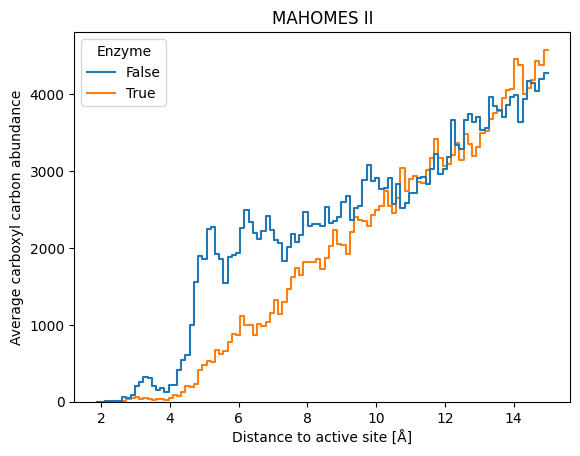

In [41]:
ax15 = sns.histplot(data=df15, x="dist_c_metal", hue = "Enzyme", element="step", fill = False)
# Customize the plot (optional)
plt.xlabel("Distance to active site [Å]")
plt.ylabel("Average carboxyl carbon abundance")
plt.title("MAHOMES II")
plt.show()

In [32]:
df_temp = pd.read_csv('../results/df2_met_carbonyl_dist.csv', header=0)
df_temp = df_temp.loc[:, [ 'pdb_name_x', 'metal_name', 'metal_number', 'x_met', 'y_met', 'z_met', 'dist_c_metal']]
df_temp.rename(columns={'pdb_name_x': 'pdb_name'}, inplace=True)
df_temp.columns

/var/folders/v3/nq35dxlx2bxg58jt43fv2h4dcfpwcn/T/ipykernel_15312/2171067727.py:1: DtypeWarning: Columns (16,18,23) have mixed types. Specify dtype option on import or set low_memory=False.
  df_temp = pd.read_csv('../results/df2_met_carbonyl_dist.csv', header=0)


Index(['pdb_name', 'metal_name', 'metal_number', 'x_met', 'y_met', 'z_met',
       'dist_c_metal'],
      dtype='object')

In [12]:
#extract_c_carbonyl("7adh_A", pdb_file)
from itertools import combinations

def metal_sites(struct, pdb_file):
  metals0 = get_hetatm(struct, pdb_file)
  if len(metals0)>1:
    print(len(metals0), "metals")
    pairs_metals = combinations(metals0, 2)
    for pair in pairs_metals:
        dist_temp = calc_distance(pair[0], pair[1])
        criteria = "Multiple metals site" if dist_temp <= 5 else "Single metal site"
        print(criteria, dist_temp)
  else: 
    print(len(metals0), "metal")

In [121]:
dfcount = df_met_carbonyl_dist[["Enzyme","pdbjoin",'pdb_name_x']].groupby(["Enzyme","pdbjoin"]).agg(['count', 'nunique'])
dfcount.to_csv('../results/carbonyl_count.csv', index=True)


In [53]:
dfcount= pd.read_csv('../results/carbonyl_count.csv', header=0)
dfcount.columns
prots_by_cat = dfcount["Enzyme"].value_counts().reset_index()
prots_by_cat

,Enzyme,count
0,False,2947
1,True,974


### Function to generate bins and counts Carbons around active site

In [54]:
def bingenerator(start, end, step):
    return [start + i * step for i in range(int((end - start) / step) + 1)]

def bincount_generator(table, binwidth):
    bins01 = bingenerator(0, 15, binwidth)
    dfbins = table.groupby(['Enzyme', 
                            pd.cut(table['dist_c_metal'], bins01)]).size().reset_index(name='Count')
    pivoted_df = dfbins.pivot(index='dist_c_metal', columns='Enzyme', values='Count').reset_index()
    pivoted_df.columns = ["Distance", "Non_Enzymatic", "Enzymatic"]
    pivoted_df["F"]= pivoted_df["Non_Enzymatic"]/prots_by_cat["count"][0]
    pivoted_df["T"]= pivoted_df["Enzymatic"]/prots_by_cat["count"][1]
    pivoted_df["Location"]=0
    for i in range(len(pivoted_df["Enzymatic"])):
        pivoted_df["Location"][i] = pivoted_df["Distance"][i].mid
    #pivoted_df.to_csv("../results/%s_byprot.csv"%(table), index=False)
    pivoted_df.shape
    return pivoted_df

### Data of carbons by bins around active site

In [55]:
mah1_calpha = pd.read_csv('../results/df_met_calpha_dist.csv', header=0)
mah1_carboxyl = pd.read_csv('../results/df_met_carboxyl_dist.csv', header=0)
mah2_calpha = pd.read_csv('../results/df2_met_calpha_dist.csv', header=0)
mah2_carboxyl = pd.read_csv('../results/df2_met_carbonyl_dist.csv', header=0)

/var/folders/v3/nq35dxlx2bxg58jt43fv2h4dcfpwcn/T/ipykernel_3287/274044259.py:1: DtypeWarning: Columns (14,15) have mixed types. Specify dtype option on import or set low_memory=False.
  mah1_calpha = pd.read_csv('../results/df_met_calpha_dist.csv', header=0)
/var/folders/v3/nq35dxlx2bxg58jt43fv2h4dcfpwcn/T/ipykernel_3287/274044259.py:2: DtypeWarning: Columns (15) have mixed types. Specify dtype option on import or set low_memory=False.
  mah1_carboxyl = pd.read_csv('../results/df_met_carboxyl_dist.csv', header=0)
/var/folders/v3/nq35dxlx2bxg58jt43fv2h4dcfpwcn/T/ipykernel_3287/274044259.py:3: DtypeWarning: Columns (14,16,18,23) have mixed types. Specify dtype option on import or set low_memory=False.
  mah2_calpha = pd.read_csv('../results/df2_met_calpha_dist.csv', header=0)
/var/folders/v3/nq35dxlx2bxg58jt43fv2h4dcfpwcn/T/ipykernel_3287/274044259.py:4: DtypeWarning: Columns (16,18,23) have mixed types. Specify dtype option on import or set low_memory=False.
  mah2_carboxyl = pd.read_cs

In [56]:
mah1_calpha_bins = bincount_generator(mah1_calpha, 0.2)
mah1_carboxyl_bins = bincount_generator(mah1_carboxyl, 0.2)
mah2_calpha_bins = bincount_generator(mah2_calpha, 0.2)
mah2_carboxyl_bins = bincount_generator(mah2_carboxyl, 0.2)
mah1_calpha_bins.head(2)

/var/folders/v3/nq35dxlx2bxg58jt43fv2h4dcfpwcn/T/ipykernel_3287/1076068510.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  pivoted_df["Location"][i] = pivoted_df["Distance"][i].mid
/var/folders/v3/nq35dxlx2bxg58jt43fv2h4dcfpwcn/T/ipykernel_3287/1076068510.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  pivoted_df["Location"][i] = pivoted_df["Distance"][i].mid
/var/folders/v3/nq35dxlx2bxg58jt43fv2h4dcfpwcn/T/ipykernel_3287/1076068510.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stab

,Distance,Non_Enzymatic,Enzymatic,F,T,Location
0,"(0.0, 0.2]",0,0,0.0,0.0,0.1
1,"(0.2, 0.4]",0,0,0.0,0.0,0.3


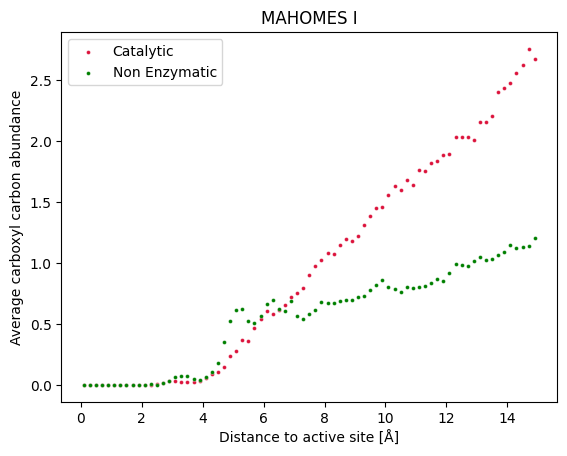

In [57]:
#sns.scatterplot(x='Location', y='T', data=mah1_calpha_bins, s= 8, color='lightsalmon', label='M1_CA Catalytic')
#sns.scatterplot(x='Location', y='F', data=mah1_calpha_bins, s= 8, color='lime',label='M1_CA Non Enzymatic')
sns.scatterplot(x='Location', y='T', data=mah1_carboxyl_bins, s= 8, color='crimson', label= 'Catalytic')
sns.scatterplot(x='Location', y='F', data=mah1_carboxyl_bins, s= 8, color='green',label='Non Enzymatic')
plt.title('MAHOMES I')
plt.xlabel("Distance to active site [Å]")
plt.ylabel("Average carboxyl carbon abundance")
plt.show()

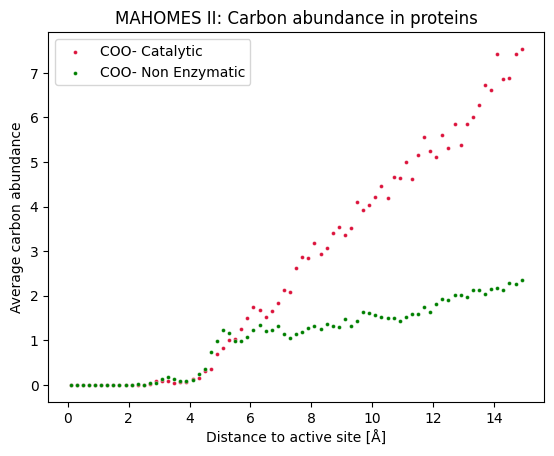

In [58]:
#sns.scatterplot(x='Location', y='T', data=mah2_calpha_bins, s= 8, color='lightsalmon', label="Cα Catalytic")
#sns.scatterplot(x='Location', y='F', data=mah2_calpha_bins, s= 8, color='lime',label='Cα Non Enzymatic')
sns.scatterplot(x='Location', y='T', data=mah2_carboxyl_bins, s= 8, color='crimson', label='COO- Catalytic')
sns.scatterplot(x='Location', y='F', data=mah2_carboxyl_bins, s= 8, color='green',label='COO- Non Enzymatic')
plt.title('MAHOMES II: Carbon abundance in proteins')
plt.xlabel("Distance to active site [Å]")
plt.ylabel("Average carbon abundance")
plt.show()

In [227]:
def all_c_carbonyls(data_directory, struc_list, threshold):
    temp_coos =  []
    for struc in struc_list:
        path2pdb = "%s/%s/%s/%s/%s_Rlx.pdb"%(data_dir, struc[0], struc[1], struc, struc)
        try:
          coo_singleprot = mindist(struc, path2pdb, threshold)
          df0 = pd.DataFrame({"dist_c_metal": coo_singleprot, "pdb_name":struc})
          print(df0.shape)
        except:
          print("failed to add LBHB for %s"%(struc))
        temp_coos.append(df0)
    all_COOs = pd.concat(temp_coos, ignore_index=True)
    print(all_COOs.shape)
  return(all_COOs)


In [ ]:
data_directory = '../data'
struc_list = pdb_list[0:len(pdb_list)-2]
allprots2 = all_c_carbonyls(data_directory, struc_list, 15)
allprots2.head(4)

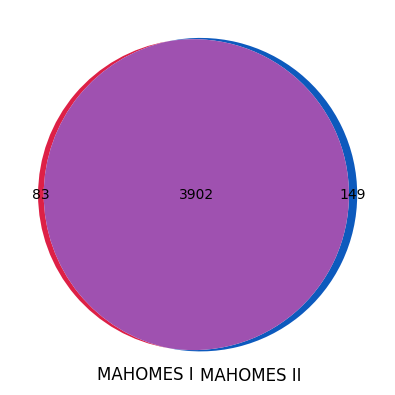

In [63]:
from matplotlib_venn import venn2
from matplotlib import pyplot as plt
# Subsets (Ab, aB, AB)
subsets = (83, 149, 3902)
set_labels = ('MAHOMES I', 'MAHOMES II')
venn2(subsets=subsets, set_labels=set_labels, set_colors=("crimson", "#0051ba"), alpha=0.95)
plt.show()
